# Problem Statement: Modelling house prices based on regression with regularization to reveal significant predictors of house prices and enable decision making for investment.
# Determination of the suitability and effectiveness of the predictors in describing house price 
# Determination of the optimal value of lambda for ridge and lasso regression

## Importing necessary libraries

In [157]:
import pandas as pd   # for sourcing dataset into a dataframe and subsequent manipulation and analysis
import numpy as np    # for numerical calculations


import matplotlib.pyplot as plt  # for data visualization
import seaborn as sns  # for aesthetic and advanced data visualization


import sklearn   # for model building
from sklearn.model_selection import train_test_split  # the train_test_split function from the sklearn library is used in to split the dataset into training and testing sets
from sklearn.preprocessing import MinMaxScaler  #the MinMaxScaler class enables scaling features
from sklearn.linear_model import LinearRegression, Ridge, Lasso # importing three classes from sklearn's linear_model module
from sklearn.feature_selection import RFE  # to enable feature selection by recursively eliminating inappropriate features
from sklearn.pipeline import Pipeline  #the Pipeline class enables sequential application of a list of transforms and a final estimator
from sklearn.model_selection import GridSearchCV # to tune hyperparameters by exhaustively considering all parameter combinations by using cross-validation to evaluate the performance of each hyperparameter set
from sklearn.metrics import mean_squared_error, r2_score   #to evaluate the performance of a regression model

from scipy import stats  #importing the stats module from the scipy library to use the statistical distributions, statistical functions and tests in the stats module

# While both sklearn and statsmodels libraries can enable building the model, statsmodels provides a more comprehensive summary of the model statistics, which justifies its utilization for the problem at hand 
import statsmodels
import statsmodels.api as sm  #for displaying detailed summary statistics of the model
from statsmodels.stats.outliers_influence import variance_inflation_factor  #to check the VIF values of feature variables

import warnings
warnings.filterwarnings('ignore') #to prevent display of warnings

## Sourcing and Understanding Data

In [158]:
df = pd.read_csv('train.csv') # importing the data into dataframe  
print ("Shape of the dataframe:", df.shape)  # printing the shape of the dataframe
df

Shape of the dataframe: (1460, 81)


,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000
5,6,50,RL,85.0,14115,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,MnPrv,Shed,700,10,2009,WD,Normal,143000
6,7,20,RL,75.0,10084,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,8,2007,WD,Normal,307000
7,8,60,RL,NaN,10382,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,Shed,350,11,2009,WD,Normal,200000
8,9,50,RM,51.0,6120,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,4,2008,WD,Abnorml,129900
9,10,190,RL,50.0,7420,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,1,2008,WD,Normal,118000


**The data dictionary provided with the source file is shown here.**

MSSubClass: Identifies the type of dwelling involved in the sale.	

        20	1-STORY 1946 & NEWER ALL STYLES
        30	1-STORY 1945 & OLDER
        40	1-STORY W/FINISHED ATTIC ALL AGES
        45	1-1/2 STORY - UNFINISHED ALL AGES
        50	1-1/2 STORY FINISHED ALL AGES
        60	2-STORY 1946 & NEWER
        70	2-STORY 1945 & OLDER
        75	2-1/2 STORY ALL AGES
        80	SPLIT OR MULTI-LEVEL
        85	SPLIT FOYER
        90	DUPLEX - ALL STYLES AND AGES
       120	1-STORY PUD (Planned Unit Development) - 1946 & NEWER
       150	1-1/2 STORY PUD - ALL AGES
       160	2-STORY PUD - 1946 & NEWER
       180	PUD - MULTILEVEL - INCL SPLIT LEV/FOYER
       190	2 FAMILY CONVERSION - ALL STYLES AND AGES

MSZoning: Identifies the general zoning classification of the sale.
		
       A	Agriculture
       C	Commercial
       FV	Floating Village Residential
       I	Industrial
       RH	Residential High Density
       RL	Residential Low Density
       RP	Residential Low Density Park 
       RM	Residential Medium Density
	
LotFrontage: Linear feet of street connected to property

LotArea: Lot size in square feet

Street: Type of road access to property

       Grvl	Gravel	
       Pave	Paved
       	
Alley: Type of alley access to property

       Grvl	Gravel
       Pave	Paved
       NA 	No alley access
		
LotShape: General shape of property

       Reg	Regular	
       IR1	Slightly irregular
       IR2	Moderately Irregular
       IR3	Irregular
       
LandContour: Flatness of the property

       Lvl	Near Flat/Level	
       Bnk	Banked - Quick and significant rise from street grade to building
       HLS	Hillside - Significant slope from side to side
       Low	Depression
		
Utilities: Type of utilities available
		
       AllPub	All public Utilities (E,G,W,& S)	
       NoSewr	Electricity, Gas, and Water (Septic Tank)
       NoSeWa	Electricity and Gas Only
       ELO	Electricity only	
	
LotConfig: Lot configuration

       Inside	Inside lot
       Corner	Corner lot
       CulDSac	Cul-de-sac
       FR2	Frontage on 2 sides of property
       FR3	Frontage on 3 sides of property
	
LandSlope: Slope of property
		
       Gtl	Gentle slope
       Mod	Moderate Slope	
       Sev	Severe Slope
	
Neighborhood: Physical locations within Ames city limits

       Blmngtn	Bloomington Heights
       Blueste	Bluestem
       BrDale	Briardale
       BrkSide	Brookside
       ClearCr	Clear Creek
       CollgCr	College Creek
       Crawfor	Crawford
       Edwards	Edwards
       Gilbert	Gilbert
       IDOTRR	Iowa DOT and Rail Road
       MeadowV	Meadow Village
       Mitchel	Mitchell
       Names	North Ames
       NoRidge	Northridge
       NPkVill	Northpark Villa
       NridgHt	Northridge Heights
       NWAmes	Northwest Ames
       OldTown	Old Town
       SWISU	South & West of Iowa State University
       Sawyer	Sawyer
       SawyerW	Sawyer West
       Somerst	Somerset
       StoneBr	Stone Brook
       Timber	Timberland
       Veenker	Veenker
			
Condition1: Proximity to various conditions
	
       Artery	Adjacent to arterial street
       Feedr	Adjacent to feeder street	
       Norm	Normal	
       RRNn	Within 200' of North-South Railroad
       RRAn	Adjacent to North-South Railroad
       PosN	Near positive off-site feature--park, greenbelt, etc.
       PosA	Adjacent to postive off-site feature
       RRNe	Within 200' of East-West Railroad
       RRAe	Adjacent to East-West Railroad
	
Condition2: Proximity to various conditions (if more than one is present)
		
       Artery	Adjacent to arterial street
       Feedr	Adjacent to feeder street	
       Norm	Normal	
       RRNn	Within 200' of North-South Railroad
       RRAn	Adjacent to North-South Railroad
       PosN	Near positive off-site feature--park, greenbelt, etc.
       PosA	Adjacent to postive off-site feature
       RRNe	Within 200' of East-West Railroad
       RRAe	Adjacent to East-West Railroad
	
BldgType: Type of dwelling
		
       1Fam	Single-family Detached	
       2FmCon	Two-family Conversion; originally built as one-family dwelling
       Duplx	Duplex
       TwnhsE	Townhouse End Unit
       TwnhsI	Townhouse Inside Unit
	
HouseStyle: Style of dwelling
	
       1Story	One story
       1.5Fin	One and one-half story: 2nd level finished
       1.5Unf	One and one-half story: 2nd level unfinished
       2Story	Two story
       2.5Fin	Two and one-half story: 2nd level finished
       2.5Unf	Two and one-half story: 2nd level unfinished
       SFoyer	Split Foyer
       SLvl	Split Level
	
OverallQual: Rates the overall material and finish of the house

       10	Very Excellent
       9	Excellent
       8	Very Good
       7	Good
       6	Above Average
       5	Average
       4	Below Average
       3	Fair
       2	Poor
       1	Very Poor
	
OverallCond: Rates the overall condition of the house

       10	Very Excellent
       9	Excellent
       8	Very Good
       7	Good
       6	Above Average	
       5	Average
       4	Below Average	
       3	Fair
       2	Poor
       1	Very Poor
		
YearBuilt: Original construction date

YearRemodAdd: Remodel date (same as construction date if no remodeling or additions)

RoofStyle: Type of roof

       Flat	Flat
       Gable	Gable
       Gambrel	Gabrel (Barn)
       Hip	Hip
       Mansard	Mansard
       Shed	Shed
		
RoofMatl: Roof material

       ClyTile	Clay or Tile
       CompShg	Standard (Composite) Shingle
       Membran	Membrane
       Metal	Metal
       Roll	Roll
       Tar&Grv	Gravel & Tar
       WdShake	Wood Shakes
       WdShngl	Wood Shingles
		
Exterior1st: Exterior covering on house

       AsbShng	Asbestos Shingles
       AsphShn	Asphalt Shingles
       BrkComm	Brick Common
       BrkFace	Brick Face
       CBlock	Cinder Block
       CemntBd	Cement Board
       HdBoard	Hard Board
       ImStucc	Imitation Stucco
       MetalSd	Metal Siding
       Other	Other
       Plywood	Plywood
       PreCast	PreCast	
       Stone	Stone
       Stucco	Stucco
       VinylSd	Vinyl Siding
       Wd Sdng	Wood Siding
       WdShing	Wood Shingles
	
Exterior2nd: Exterior covering on house (if more than one material)

       AsbShng	Asbestos Shingles
       AsphShn	Asphalt Shingles
       BrkComm	Brick Common
       BrkFace	Brick Face
       CBlock	Cinder Block
       CemntBd	Cement Board
       HdBoard	Hard Board
       ImStucc	Imitation Stucco
       MetalSd	Metal Siding
       Other	Other
       Plywood	Plywood
       PreCast	PreCast
       Stone	Stone
       Stucco	Stucco
       VinylSd	Vinyl Siding
       Wd Sdng	Wood Siding
       WdShing	Wood Shingles
	
MasVnrType: Masonry veneer type

       BrkCmn	Brick Common
       BrkFace	Brick Face
       CBlock	Cinder Block
       None	None
       Stone	Stone
	
MasVnrArea: Masonry veneer area in square feet

ExterQual: Evaluates the quality of the material on the exterior 
		
       Ex	Excellent
       Gd	Good
       TA	Average/Typical
       Fa	Fair
       Po	Poor
		
ExterCond: Evaluates the present condition of the material on the exterior
		
       Ex	Excellent
       Gd	Good
       TA	Average/Typical
       Fa	Fair
       Po	Poor
		
Foundation: Type of foundation
		
       BrkTil	Brick & Tile
       CBlock	Cinder Block
       PConc	Poured Contrete	
       Slab	Slab
       Stone	Stone
       Wood	Wood
		
BsmtQual: Evaluates the height of the basement

       Ex	Excellent (100+ inches)	
       Gd	Good (90-99 inches)
       TA	Typical (80-89 inches)
       Fa	Fair (70-79 inches)
       Po	Poor (<70 inches
       NA	No Basement
		
BsmtCond: Evaluates the general condition of the basement

       Ex	Excellent
       Gd	Good
       TA	Typical - slight dampness allowed
       Fa	Fair - dampness or some cracking or settling
       Po	Poor - Severe cracking, settling, or wetness
       NA	No Basement
	
BsmtExposure: Refers to walkout or garden level walls

       Gd	Good Exposure
       Av	Average Exposure (split levels or foyers typically score average or above)	
       Mn	Mimimum Exposure
       No	No Exposure
       NA	No Basement
	
BsmtFinType1: Rating of basement finished area

       GLQ	Good Living Quarters
       ALQ	Average Living Quarters
       BLQ	Below Average Living Quarters	
       Rec	Average Rec Room
       LwQ	Low Quality
       Unf	Unfinshed
       NA	No Basement
		
BsmtFinSF1: Type 1 finished square feet

BsmtFinType2: Rating of basement finished area (if multiple types)

       GLQ	Good Living Quarters
       ALQ	Average Living Quarters
       BLQ	Below Average Living Quarters	
       Rec	Average Rec Room
       LwQ	Low Quality
       Unf	Unfinshed
       NA	No Basement

BsmtFinSF2: Type 2 finished square feet

BsmtUnfSF: Unfinished square feet of basement area

TotalBsmtSF: Total square feet of basement area

Heating: Type of heating
		
       Floor	Floor Furnace
       GasA	Gas forced warm air furnace
       GasW	Gas hot water or steam heat
       Grav	Gravity furnace	
       OthW	Hot water or steam heat other than gas
       Wall	Wall furnace
		
HeatingQC: Heating quality and condition

       Ex	Excellent
       Gd	Good
       TA	Average/Typical
       Fa	Fair
       Po	Poor
		
CentralAir: Central air conditioning

       N	No
       Y	Yes
		
Electrical: Electrical system

       SBrkr	Standard Circuit Breakers & Romex
       FuseA	Fuse Box over 60 AMP and all Romex wiring (Average)	
       FuseF	60 AMP Fuse Box and mostly Romex wiring (Fair)
       FuseP	60 AMP Fuse Box and mostly knob & tube wiring (poor)
       Mix	Mixed
		
1stFlrSF: First Floor square feet
 
2ndFlrSF: Second floor square feet

LowQualFinSF: Low quality finished square feet (all floors)

GrLivArea: Above grade (ground) living area square feet

BsmtFullBath: Basement full bathrooms

BsmtHalfBath: Basement half bathrooms

FullBath: Full bathrooms above grade

HalfBath: Half baths above grade

Bedroom: Bedrooms above grade (does NOT include basement bedrooms)

Kitchen: Kitchens above grade

KitchenQual: Kitchen quality

       Ex	Excellent
       Gd	Good
       TA	Typical/Average
       Fa	Fair
       Po	Poor
       	
TotRmsAbvGrd: Total rooms above grade (does not include bathrooms)

Functional: Home functionality (Assume typical unless deductions are warranted)

       Typ	Typical Functionality
       Min1	Minor Deductions 1
       Min2	Minor Deductions 2
       Mod	Moderate Deductions
       Maj1	Major Deductions 1
       Maj2	Major Deductions 2
       Sev	Severely Damaged
       Sal	Salvage only
		
Fireplaces: Number of fireplaces

FireplaceQu: Fireplace quality

       Ex	Excellent - Exceptional Masonry Fireplace
       Gd	Good - Masonry Fireplace in main level
       TA	Average - Prefabricated Fireplace in main living area or Masonry Fireplace in basement
       Fa	Fair - Prefabricated Fireplace in basement
       Po	Poor - Ben Franklin Stove
       NA	No Fireplace
		
GarageType: Garage location
		
       2Types	More than one type of garage
       Attchd	Attached to home
       Basment	Basement Garage
       BuiltIn	Built-In (Garage part of house - typically has room above garage)
       CarPort	Car Port
       Detchd	Detached from home
       NA	No Garage
		
GarageYrBlt: Year garage was built
		
GarageFinish: Interior finish of the garage

       Fin	Finished
       RFn	Rough Finished	
       Unf	Unfinished
       NA	No Garage
		
GarageCars: Size of garage in car capacity

GarageArea: Size of garage in square feet

GarageQual: Garage quality

       Ex	Excellent
       Gd	Good
       TA	Typical/Average
       Fa	Fair
       Po	Poor
       NA	No Garage
		
GarageCond: Garage condition

       Ex	Excellent
       Gd	Good
       TA	Typical/Average
       Fa	Fair
       Po	Poor
       NA	No Garage
		
PavedDrive: Paved driveway

       Y	Paved 
       P	Partial Pavement
       N	Dirt/Gravel
		
WoodDeckSF: Wood deck area in square feet

OpenPorchSF: Open porch area in square feet

EnclosedPorch: Enclosed porch area in square feet

3SsnPorch: Three season porch area in square feet

ScreenPorch: Screen porch area in square feet

PoolArea: Pool area in square feet

PoolQC: Pool quality
		
       Ex	Excellent
       Gd	Good
       TA	Average/Typical
       Fa	Fair
       NA	No Pool
		
Fence: Fence quality
		
       GdPrv	Good Privacy
       MnPrv	Minimum Privacy
       GdWo	Good Wood
       MnWw	Minimum Wood/Wire
       NA	No Fence
	
MiscFeature: Miscellaneous feature not covered in other categories
		
       Elev	Elevator
       Gar2	2nd Garage (if not described in garage section)
       Othr	Other
       Shed	Shed (over 100 SF)
       TenC	Tennis Court
       NA	None
		
MiscVal: $Value of miscellaneous feature

MoSold: Month Sold (MM)

YrSold: Year Sold (YYYY)

SaleType: Type of sale
		
       WD 	Warranty Deed - Conventional
       CWD	Warranty Deed - Cash
       VWD	Warranty Deed - VA Loan
       New	Home just constructed and sold
       COD	Court Officer Deed/Estate
       Con	Contract 15% Down payment regular terms
       ConLw	Contract Low Down payment and low interest
       ConLI	Contract Low Interest
       ConLD	Contract Low Down
       Oth	Other
		
SaleCondition: Condition of sale

       Normal	Normal Sale
       Abnorml	Abnormal Sale -  trade, foreclosure, short sale
       AdjLand	Adjoining Land Purchase
       Alloca	Allocation - two linked properties with separate deeds, typically condo with a garage unit	
       Family	Sale between family members
       Partial	Home was not completed when last assessed (associated with New Homes)

In [159]:
print ("Shape of dataframe", df.shape,"\n")    #printing the shape of dataframe
# printing some basic information about the dataset to particularly view the column names and the datatype and non-null count of every column
print(df.info(show_counts = True,verbose = True))

Shape of dataframe (1460, 81) 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1460 non-null   int64  
 1   MSSubClass     1460 non-null   int64  
 2   MSZoning       1460 non-null   object 
 3   LotFrontage    1201 non-null   float64
 4   LotArea        1460 non-null   int64  
 5   Street         1460 non-null   object 
 6   Alley          91 non-null     object 
 7   LotShape       1460 non-null   object 
 8   LandContour    1460 non-null   object 
 9   Utilities      1460 non-null   object 
 10  LotConfig      1460 non-null   object 
 11  LandSlope      1460 non-null   object 
 12  Neighborhood   1460 non-null   object 
 13  Condition1     1460 non-null   object 
 14  Condition2     1460 non-null   object 
 15  BldgType       1460 non-null   object 
 16  HouseStyle     1460 non-null   object 
 17  OverallQual    1460 

## Data Preparation

For clarity, we temporarily typecast the catagorical variables as object type based on information in the data dictionary. Furthermore, we broadly divide all variables into two types - Categorical variables and Numeric variables.

In [160]:
print ("shape of dataframe",df.shape)

categorical_variables = ['MSSubClass', 'MSZoning', 'Street', 'LotShape', 'LandContour', 'Utilities', 'LotConfig', 'LandSlope', 'Neighborhood', 'Condition1', 'Condition2', 'BldgType', 'HouseStyle', 'OverallQual', 'OverallCond', 'RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType', 'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual', 'BsmtCond','BsmtExposure', 'BsmtFinType1', 'BsmtFinType2', 'Heating', 'HeatingQC', 'CentralAir', 'Electrical', 'KitchenQual', 'TotRmsAbvGrd','Functional', 'GarageType', 'GarageFinish', 'GarageQual', 'GarageCond', 'PavedDrive', 'SaleType', 'SaleCondition','Alley', 'FireplaceQu', 'PoolQC', 'Fence', 'MiscFeature']
df[categorical_variables] =  df[categorical_variables].astype('object')
print ("number of categorical variables",len(categorical_variables))

numeric_variables = [col for col in df.columns.to_list() if col not in categorical_variables]
print ("number of numeric variables",len(numeric_variables))

shape of dataframe (1460, 81)
number of categorical variables 47
number of numeric variables 34


We can drop 'Id' as it is irelevant to our analysis

In [161]:
df = df.drop(['Id'],axis=1) 
numeric_variables.remove('Id') #updating the list numeric_variables

In [162]:
temp = df.isnull().sum()    # storing the count of null values in each column in a temporary series
df_temp = temp.to_frame(name="CountofNull") # converting the series to a dataframe 
print ("A view of the variables with atleast 1 null value")
df_temp[df_temp['CountofNull']!=0]

A view of the variables with atleast 1 null value


,CountofNull
LotFrontage,259
Alley,1369
MasVnrType,8
MasVnrArea,8
BsmtQual,37
BsmtCond,37
BsmtExposure,38
BsmtFinType1,37
BsmtFinType2,38
Electrical,1


#### Here, we can observe that out of 1460 records, 'PoolQC', 'Fence', 'MiscFeature', 'FireplaceQu', and 'Alley' have almost 50% or more null values. So, we proceed with dropping these columns.

In [163]:
df = df.drop(['PoolQC', 'Fence', 'MiscFeature', 'FireplaceQu', 'Alley'],axis=1) 
categorical_variables = [col for col in categorical_variables if col not in ['PoolQC', 'Fence', 'MiscFeature', 'FireplaceQu', 'Alley']] #updating catagorical variables
print (df.shape)

(1460, 75)


In [164]:
#placing all the columns with null values in a list
lst_with_null = df_temp[df_temp['CountofNull']!=0].index.to_list() 

#updating this list to remove the dropped columns
updated_lst_with_null = [ele for ele in lst_with_null if ele not in ['PoolQC', 'Fence', 'MiscFeature', 'FireplaceQu', 'Alley']]

data_types = df.dtypes[updated_lst_with_null] 
print ("A view of the data types of the columns which have null values")
data_types

A view of the data types of the columns which have null values


LotFrontage     float64
MasVnrType       object
MasVnrArea      float64
BsmtQual         object
BsmtCond         object
BsmtExposure     object
BsmtFinType1     object
BsmtFinType2     object
Electrical       object
GarageType       object
GarageYrBlt     float64
GarageFinish     object
GarageQual       object
GarageCond       object
dtype: object

### Null value imputation

In [165]:
#Imputing missing values in the numeric 'LotFrontage' and 'MasVnrArea' columns with the median
df['LotFrontage'].fillna(df['LotFrontage'].median(), inplace=True)
df['MasVnrArea'].fillna(df['MasVnrArea'].median(), inplace=True)

In [166]:
#Imputing missing values in the catagorical columns with the mode
cat_val_null = ['MasVnrType', 'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2', 'Electrical', 'GarageType', 'GarageYrBlt', 'GarageFinish', 'GarageQual', 'GarageCond']
for col in cat_val_null:
    mode_value = df[col].mode().iloc[0]
    df[col].fillna(mode_value, inplace=True)

#### Deriving columns

In [167]:
# Creating a new column 'HouseAge' which is the difference between 'YrSold' and 'YearBuilt'
df['PropertyAge'] = df['YrSold'] - df['YearBuilt']

# upating the list 'numeric_variables'
numeric_variables.append('PropertyAge')

# Dropping the 'YrSold' and 'YearBuilt' columns as they are no longer needed
df = df.drop(['YrSold', 'YearBuilt'], axis=1)

numeric_variables.remove('YrSold')
numeric_variables.remove('YearBuilt')

# Addiitonally dropping 'GarageYrBlt' column as it is redundant
df = df.drop(['GarageYrBlt'], axis=1)
numeric_variables.remove('GarageYrBlt')

In [168]:
null_counts = df.isnull().sum()
if null_counts.sum() == 0:
    print("No null values in the DataFrame.")
else:
    print("Null values still exist in the DataFrame.")
    print(null_counts)

No null values in the DataFrame.


## Univariate, bivariate, and multivariate data analysis & data visualization

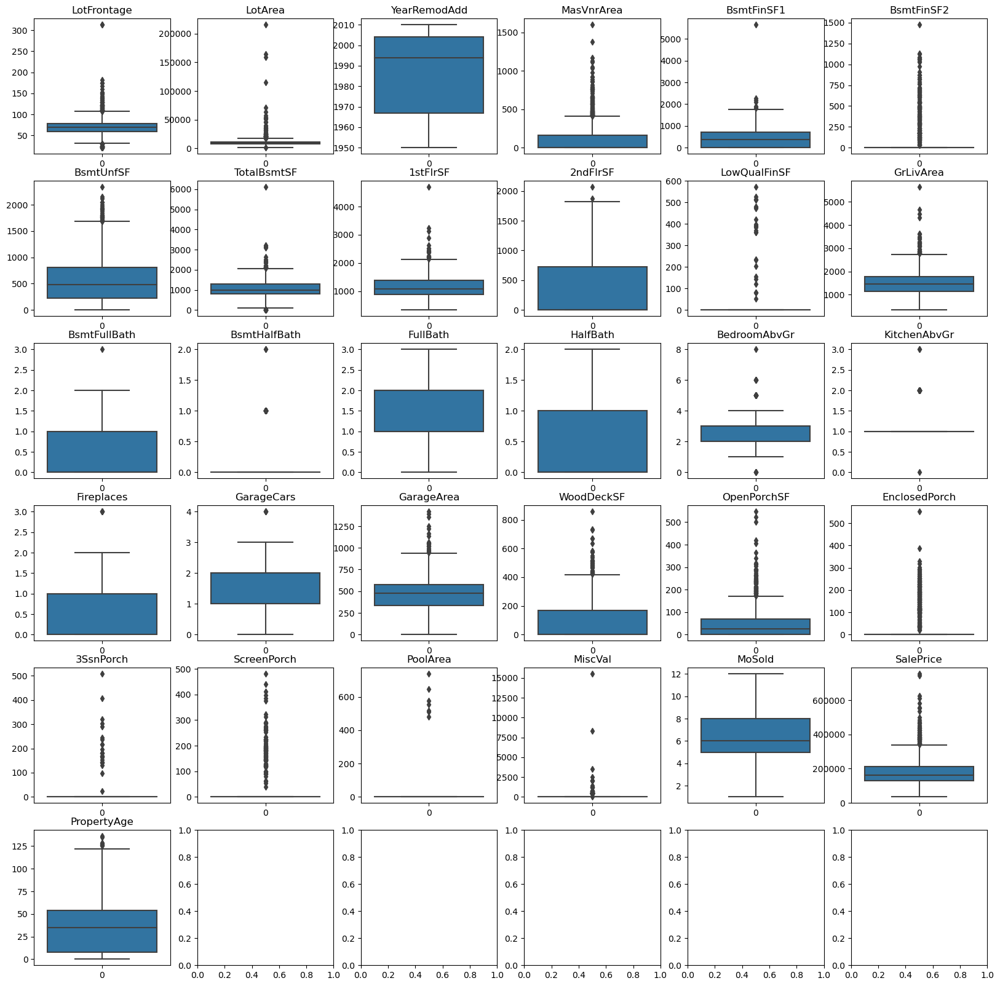

In [169]:
# Visualizing outliers through boxplots

# Setting up the subplots
fig, axes = plt.subplots(nrows=6, ncols=6, figsize=(20, 20))

# Looping through the columns and plotting each continuous variable on a boxplot
for i, j in enumerate(numeric_variables):
    row = i // 6
    col = i % 6
    ax = axes[row][col]    
    sns.boxplot(df[j], ax=ax)
    ax.set_title(j)

plt.show()

In [170]:
df.describe()

,LotFrontage,LotArea,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,...,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,SalePrice,PropertyAge
count,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,...,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000
mean,69.863699,10516.828082,1984.865753,103.117123,443.639726,46.549315,567.240411,1057.429452,1162.626712,346.992466,...,94.244521,46.660274,21.954110,3.409589,15.060959,2.758904,43.489041,6.321918,180921.195890,36.547945
std,22.027677,9981.264932,20.645407,180.731373,456.098091,161.319273,441.866955,438.705324,386.587738,436.528436,...,125.338794,66.256028,61.119149,29.317331,55.757415,40.177307,496.123024,2.703626,79442.502883,30.250152
min,21.000000,1300.000000,1950.000000,0.000000,0.000000,0.000000,0.000000,0.000000,334.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,34900.000000,0.000000
25%,60.000000,7553.500000,1967.000000,0.000000,0.000000,0.000000,223.000000,795.750000,882.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,129975.000000,8.000000
50%,69.000000,9478.500000,1994.000000,0.000000,383.500000,0.000000,477.500000,991.500000,1087.000000,0.000000,...,0.000000,25.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,163000.000000,35.000000
75%,79.000000,11601.500000,2004.000000,164.250000,712.250000,0.000000,808.000000,1298.250000,1391.250000,728.000000,...,168.000000,68.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,214000.000000,54.000000
max,313.000000,215245.000000,2010.000000,1600.000000,5644.000000,1474.000000,2336.000000,6110.000000,4692.000000,2065.000000,...,857.000000,547.000000,552.000000,508.000000,480.000000,738.000000,15500.000000,12.000000,755000.000000,136.000000


Although we note some outliers, since the dataset provided is already very small, further elimination/manipulation of data to remove outliers would not be appropriate. 

In [171]:
# Checking the percentage of outliers for the numeric columns

for var in numeric_variables:
    # Calculate the IQR for the current variable
    Q1 = df[var].quantile(0.25)
    Q3 = df[var].quantile(0.75)
    IQR = Q3 - Q1

    # Calculate the upper and lower bounds for outliers
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    # Find the percentiles of outliers for the current variable
    lower_percentile = (df[var] < lower_bound).mean() * 100
    upper_percentile = (df[var] > upper_bound).mean() * 100

    print(f"Percentile of outliers below the lower bound in {var}: {lower_percentile:.2f}%")
    print(f"Percentile of outliers above the upper bound in {var}: {upper_percentile:.2f}%")

Percentile of outliers below the lower bound in LotFrontage: 3.29%
Percentile of outliers above the upper bound in LotFrontage: 3.97%
Percentile of outliers below the lower bound in LotArea: 0.14%
Percentile of outliers above the upper bound in LotArea: 4.59%
Percentile of outliers below the lower bound in YearRemodAdd: 0.00%
Percentile of outliers above the upper bound in YearRemodAdd: 0.00%
Percentile of outliers below the lower bound in MasVnrArea: 0.00%
Percentile of outliers above the upper bound in MasVnrArea: 6.71%
Percentile of outliers below the lower bound in BsmtFinSF1: 0.00%
Percentile of outliers above the upper bound in BsmtFinSF1: 0.48%
Percentile of outliers below the lower bound in BsmtFinSF2: 0.00%
Percentile of outliers above the upper bound in BsmtFinSF2: 11.44%
Percentile of outliers below the lower bound in BsmtUnfSF: 0.00%
Percentile of outliers above the upper bound in BsmtUnfSF: 1.99%
Percentile of outliers below the lower bound in TotalBsmtSF: 2.53%
Percentile

In [172]:
# Checking the percentage of unique values for the numeric columns

for var in numeric_variables:
    unique_counts = df[var].value_counts()
    num_unique_values = len(unique_counts)
    total_data_points = len(df)
    unique_percent = (num_unique_values / total_data_points) * 100

    print(f"Unique values in '{var}': {num_unique_values}, Unique Percentage: {unique_percent:.2f}%")

Unique values in 'LotFrontage': 110, Unique Percentage: 7.53%
Unique values in 'LotArea': 1073, Unique Percentage: 73.49%
Unique values in 'YearRemodAdd': 61, Unique Percentage: 4.18%
Unique values in 'MasVnrArea': 327, Unique Percentage: 22.40%
Unique values in 'BsmtFinSF1': 637, Unique Percentage: 43.63%
Unique values in 'BsmtFinSF2': 144, Unique Percentage: 9.86%
Unique values in 'BsmtUnfSF': 780, Unique Percentage: 53.42%
Unique values in 'TotalBsmtSF': 721, Unique Percentage: 49.38%
Unique values in '1stFlrSF': 753, Unique Percentage: 51.58%
Unique values in '2ndFlrSF': 417, Unique Percentage: 28.56%
Unique values in 'LowQualFinSF': 24, Unique Percentage: 1.64%
Unique values in 'GrLivArea': 861, Unique Percentage: 58.97%
Unique values in 'BsmtFullBath': 4, Unique Percentage: 0.27%
Unique values in 'BsmtHalfBath': 3, Unique Percentage: 0.21%
Unique values in 'FullBath': 4, Unique Percentage: 0.27%
Unique values in 'HalfBath': 3, Unique Percentage: 0.21%
Unique values in 'BedroomAbv

Frequency count for MSSubClass:
20     536
60     299
50     144
120     87
30      69
160     63
70      60
80      58
90      52
190     30
85      20
75      16
45      12
180     10
40       4
Name: MSSubClass, dtype: int64



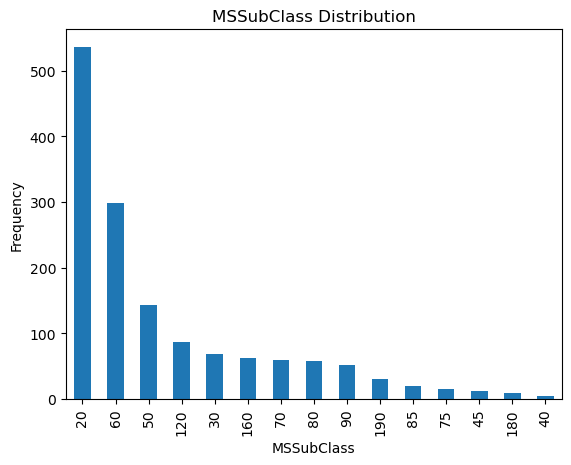

Frequency count for MSZoning:
RL         1151
RM          218
FV           65
RH           16
C (all)      10
Name: MSZoning, dtype: int64



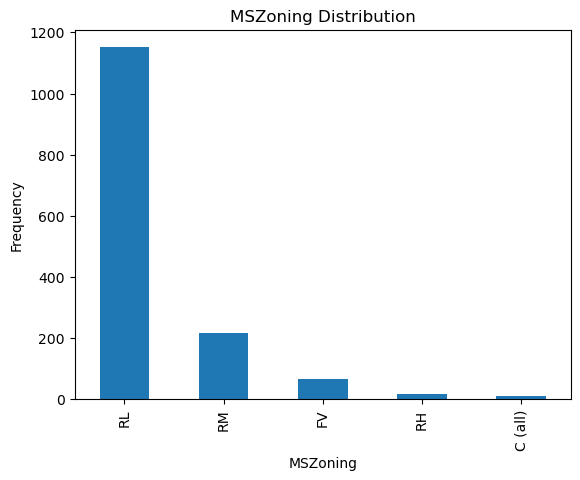

Frequency count for Street:
Pave    1454
Grvl       6
Name: Street, dtype: int64



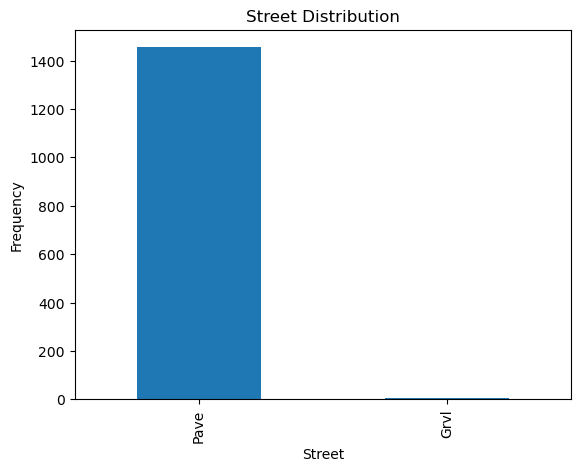

Frequency count for LotShape:
Reg    925
IR1    484
IR2     41
IR3     10
Name: LotShape, dtype: int64



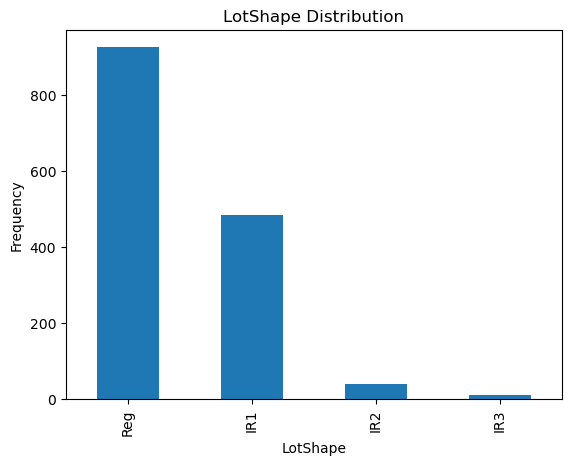

Frequency count for LandContour:
Lvl    1311
Bnk      63
HLS      50
Low      36
Name: LandContour, dtype: int64



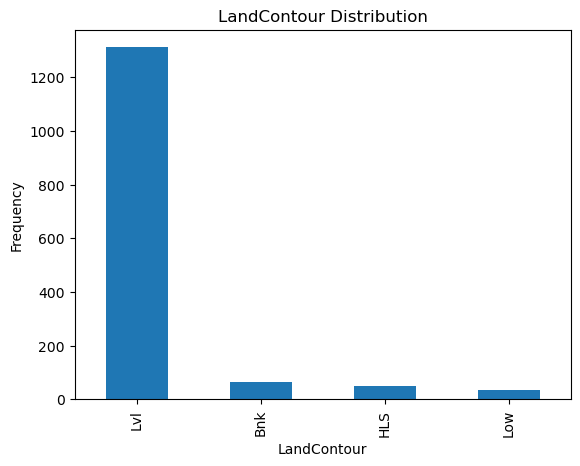

Frequency count for Utilities:
AllPub    1459
NoSeWa       1
Name: Utilities, dtype: int64



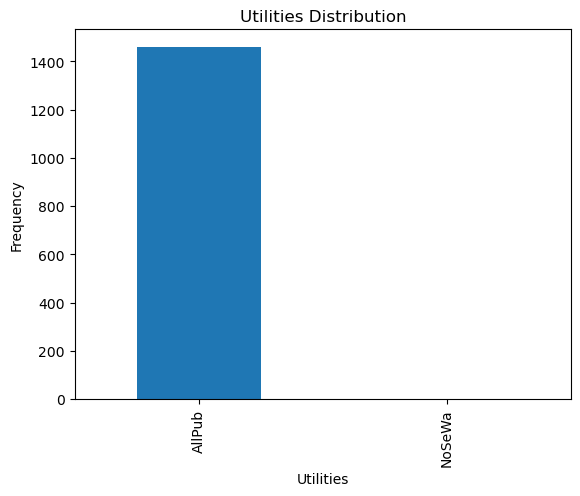

Frequency count for LotConfig:
Inside     1052
Corner      263
CulDSac      94
FR2          47
FR3           4
Name: LotConfig, dtype: int64



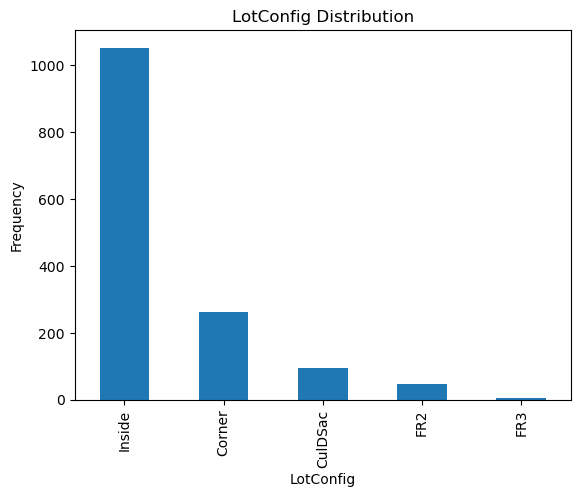

Frequency count for LandSlope:
Gtl    1382
Mod      65
Sev      13
Name: LandSlope, dtype: int64



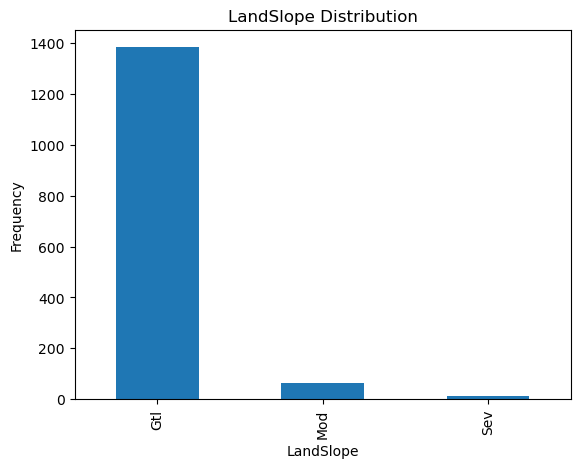

Frequency count for Neighborhood:
NAmes      225
CollgCr    150
OldTown    113
Edwards    100
Somerst     86
Gilbert     79
NridgHt     77
Sawyer      74
NWAmes      73
SawyerW     59
BrkSide     58
Crawfor     51
Mitchel     49
NoRidge     41
Timber      38
IDOTRR      37
ClearCr     28
StoneBr     25
SWISU       25
MeadowV     17
Blmngtn     17
BrDale      16
Veenker     11
NPkVill      9
Blueste      2
Name: Neighborhood, dtype: int64



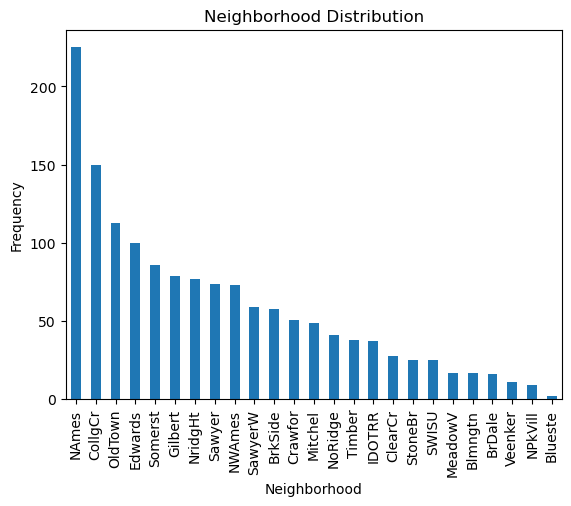

Frequency count for Condition1:
Norm      1260
Feedr       81
Artery      48
RRAn        26
PosN        19
RRAe        11
PosA         8
RRNn         5
RRNe         2
Name: Condition1, dtype: int64



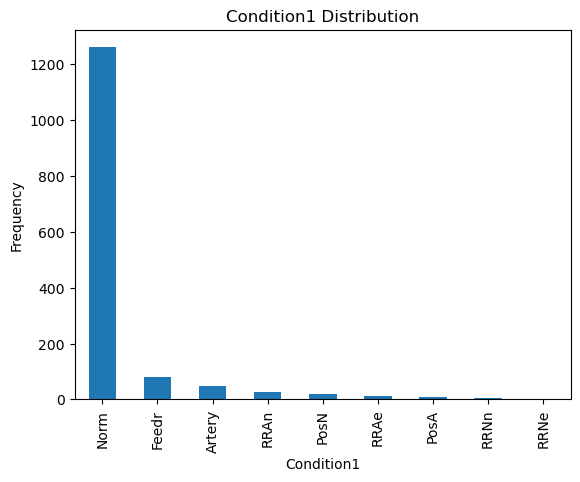

Frequency count for Condition2:
Norm      1445
Feedr        6
Artery       2
RRNn         2
PosN         2
PosA         1
RRAn         1
RRAe         1
Name: Condition2, dtype: int64



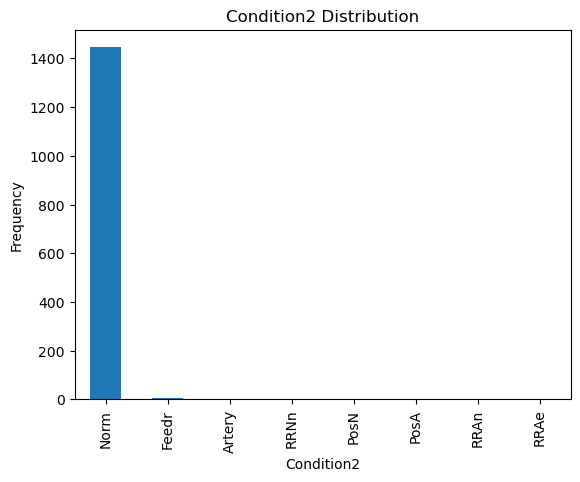

Frequency count for BldgType:
1Fam      1220
TwnhsE     114
Duplex      52
Twnhs       43
2fmCon      31
Name: BldgType, dtype: int64



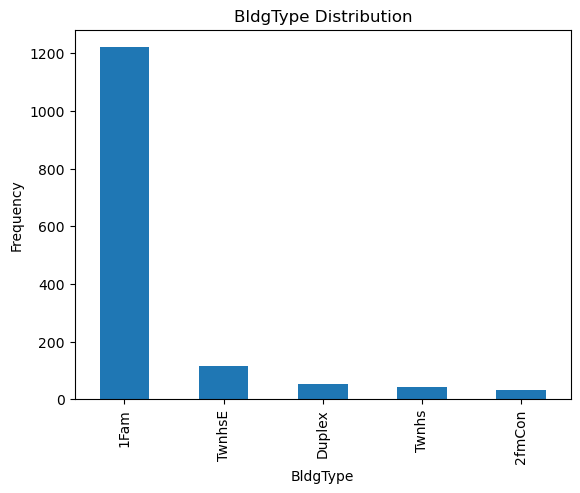

Frequency count for HouseStyle:
1Story    726
2Story    445
1.5Fin    154
SLvl       65
SFoyer     37
1.5Unf     14
2.5Unf     11
2.5Fin      8
Name: HouseStyle, dtype: int64



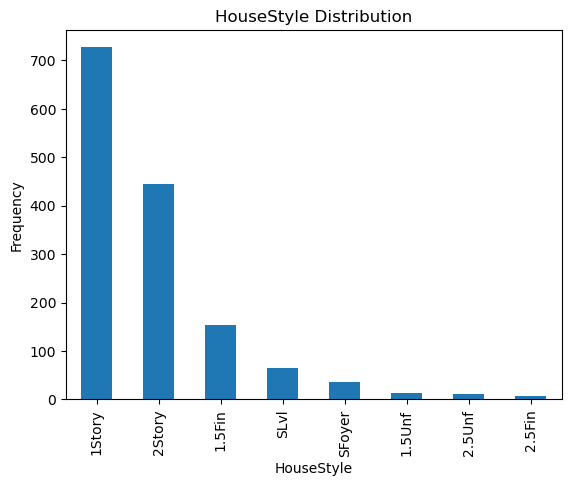

Frequency count for OverallQual:
5     397
6     374
7     319
8     168
4     116
9      43
3      20
10     18
2       3
1       2
Name: OverallQual, dtype: int64



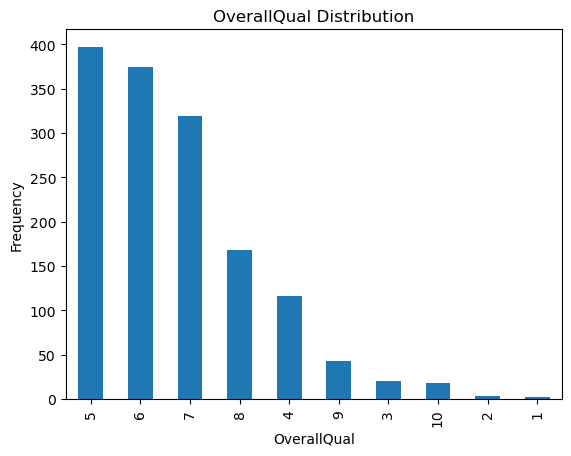

Frequency count for OverallCond:
5    821
6    252
7    205
8     72
4     57
3     25
9     22
2      5
1      1
Name: OverallCond, dtype: int64



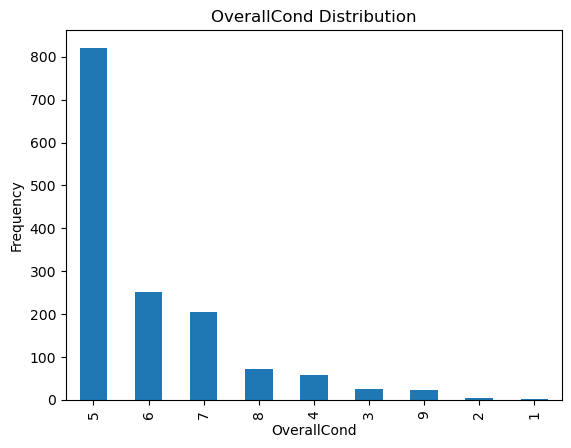

Frequency count for RoofStyle:
Gable      1141
Hip         286
Flat         13
Gambrel      11
Mansard       7
Shed          2
Name: RoofStyle, dtype: int64



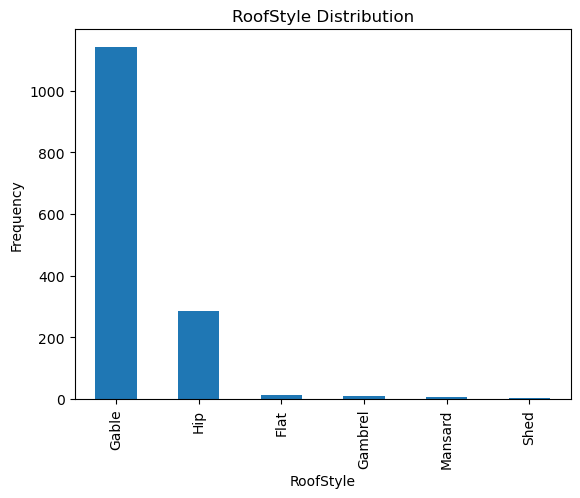

Frequency count for RoofMatl:
CompShg    1434
Tar&Grv      11
WdShngl       6
WdShake       5
Metal         1
Membran       1
Roll          1
ClyTile       1
Name: RoofMatl, dtype: int64



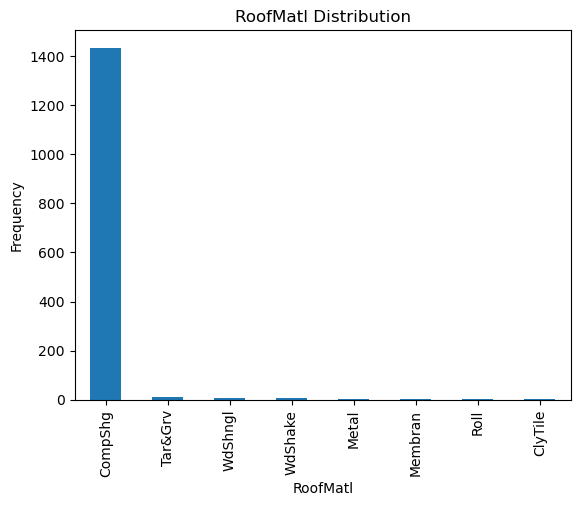

Frequency count for Exterior1st:
VinylSd    515
HdBoard    222
MetalSd    220
Wd Sdng    206
Plywood    108
CemntBd     61
BrkFace     50
WdShing     26
Stucco      25
AsbShng     20
BrkComm      2
Stone        2
AsphShn      1
ImStucc      1
CBlock       1
Name: Exterior1st, dtype: int64



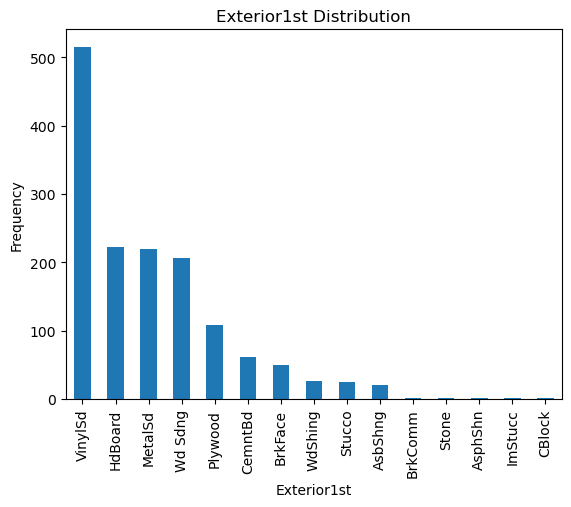

Frequency count for Exterior2nd:
VinylSd    504
MetalSd    214
HdBoard    207
Wd Sdng    197
Plywood    142
CmentBd     60
Wd Shng     38
Stucco      26
BrkFace     25
AsbShng     20
ImStucc     10
Brk Cmn      7
Stone        5
AsphShn      3
Other        1
CBlock       1
Name: Exterior2nd, dtype: int64



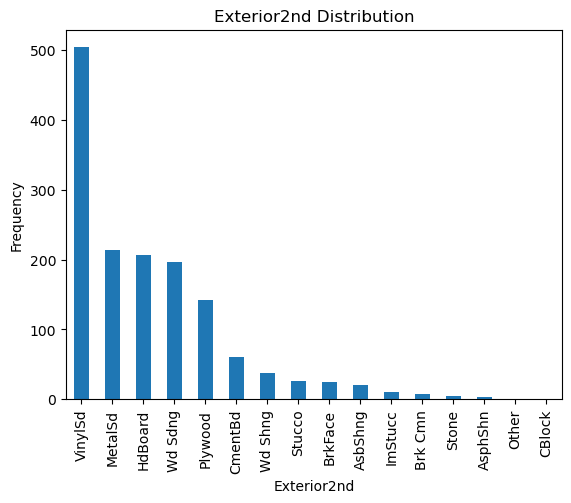

Frequency count for MasVnrType:
None       872
BrkFace    445
Stone      128
BrkCmn      15
Name: MasVnrType, dtype: int64



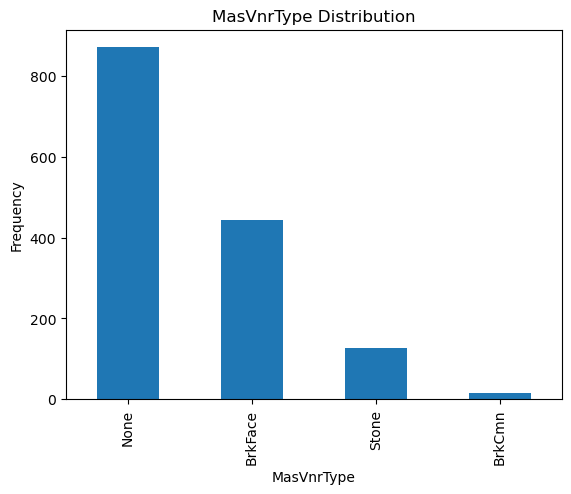

Frequency count for ExterQual:
TA    906
Gd    488
Ex     52
Fa     14
Name: ExterQual, dtype: int64



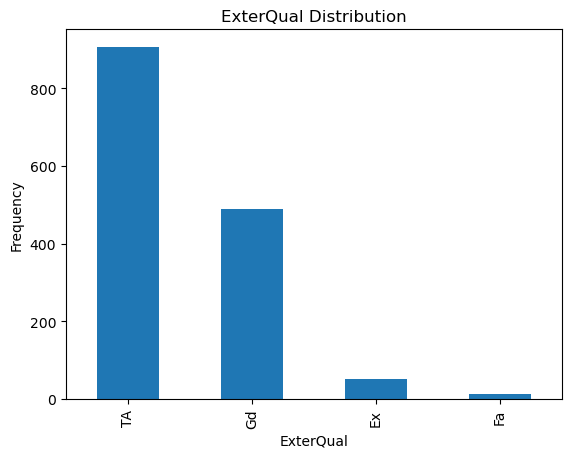

Frequency count for ExterCond:
TA    1282
Gd     146
Fa      28
Ex       3
Po       1
Name: ExterCond, dtype: int64



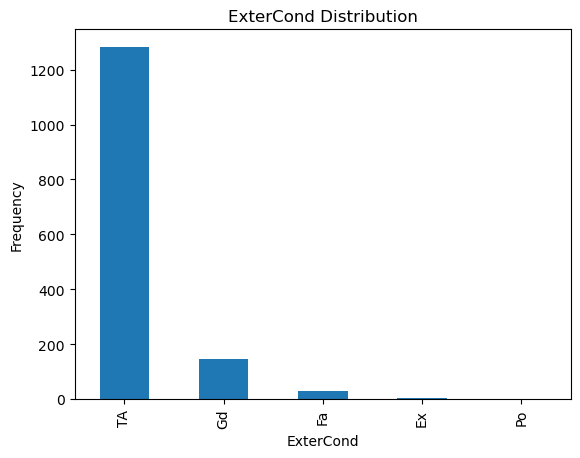

Frequency count for Foundation:
PConc     647
CBlock    634
BrkTil    146
Slab       24
Stone       6
Wood        3
Name: Foundation, dtype: int64



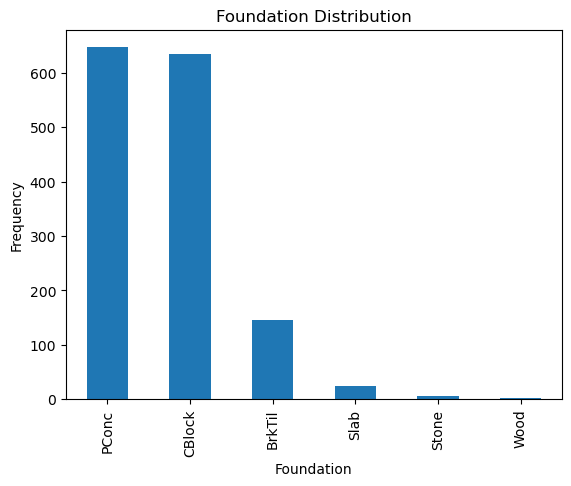

Frequency count for BsmtQual:
TA    686
Gd    618
Ex    121
Fa     35
Name: BsmtQual, dtype: int64



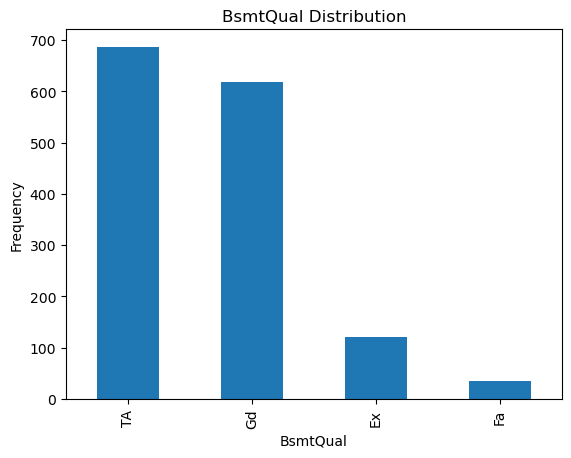

Frequency count for BsmtCond:
TA    1348
Gd      65
Fa      45
Po       2
Name: BsmtCond, dtype: int64



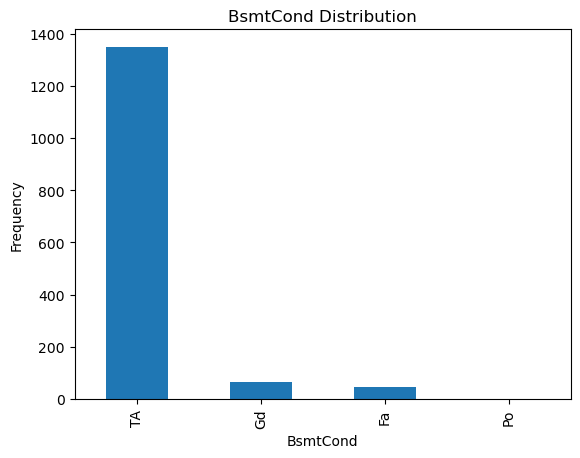

Frequency count for BsmtExposure:
No    991
Av    221
Gd    134
Mn    114
Name: BsmtExposure, dtype: int64



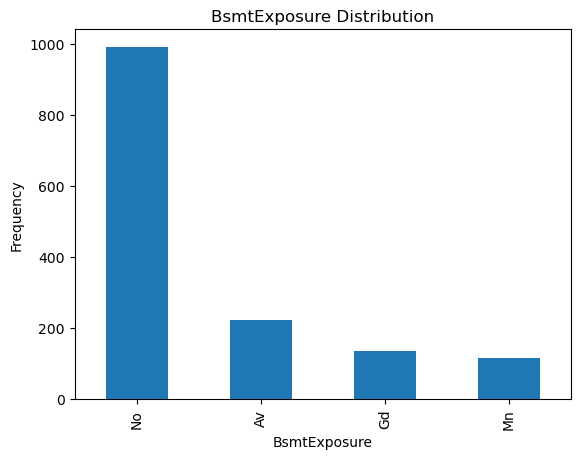

Frequency count for BsmtFinType1:
Unf    467
GLQ    418
ALQ    220
BLQ    148
Rec    133
LwQ     74
Name: BsmtFinType1, dtype: int64



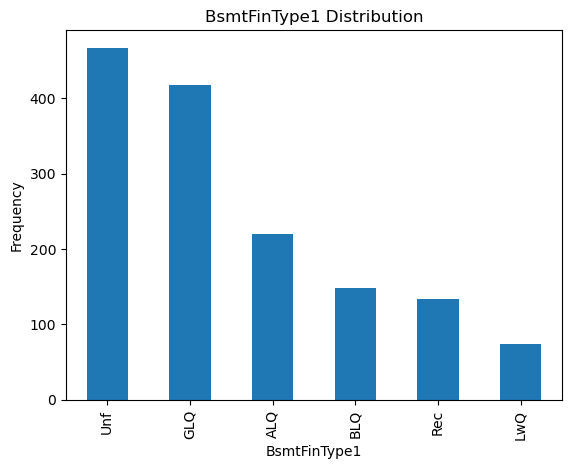

Frequency count for BsmtFinType2:
Unf    1294
Rec      54
LwQ      46
BLQ      33
ALQ      19
GLQ      14
Name: BsmtFinType2, dtype: int64



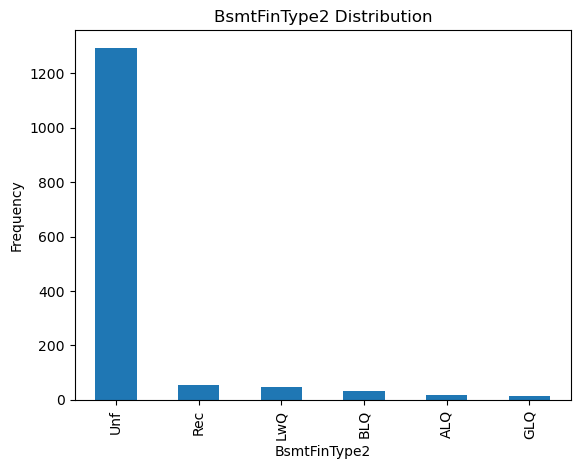

Frequency count for Heating:
GasA     1428
GasW       18
Grav        7
Wall        4
OthW        2
Floor       1
Name: Heating, dtype: int64



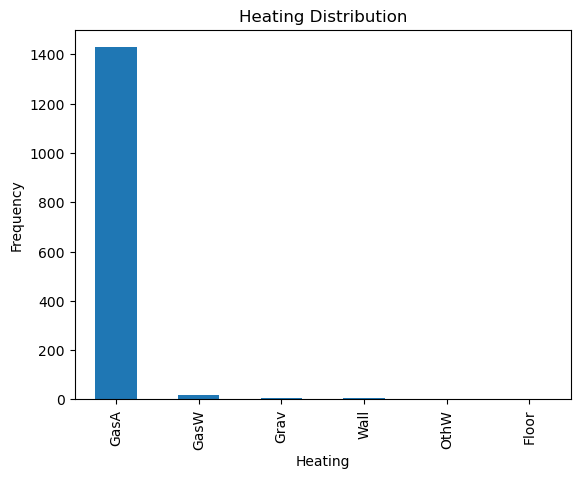

Frequency count for HeatingQC:
Ex    741
TA    428
Gd    241
Fa     49
Po      1
Name: HeatingQC, dtype: int64



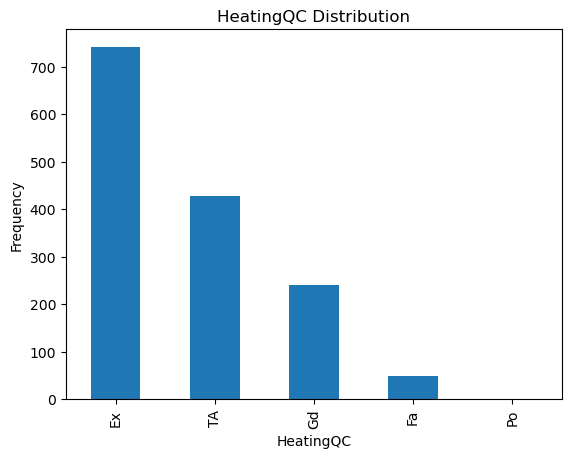

Frequency count for CentralAir:
Y    1365
N      95
Name: CentralAir, dtype: int64



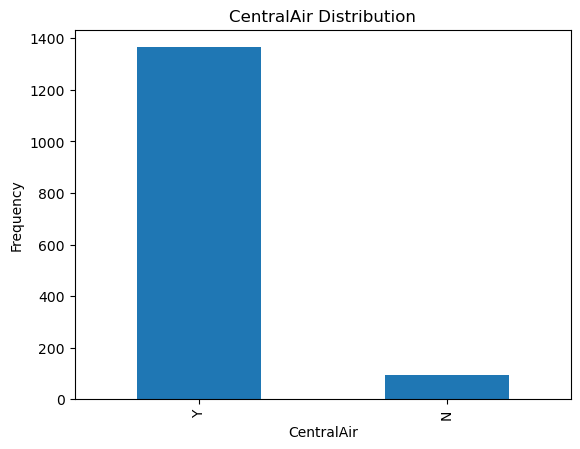

Frequency count for Electrical:
SBrkr    1335
FuseA      94
FuseF      27
FuseP       3
Mix         1
Name: Electrical, dtype: int64



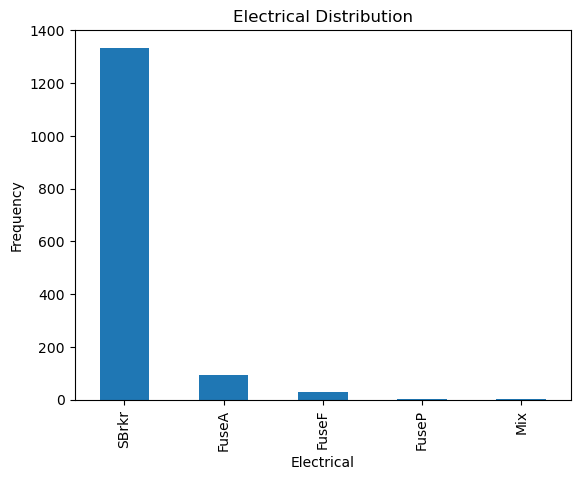

Frequency count for KitchenQual:
TA    735
Gd    586
Ex    100
Fa     39
Name: KitchenQual, dtype: int64



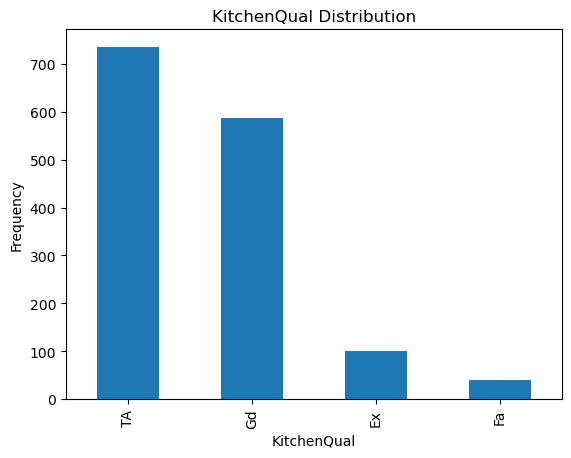

Frequency count for TotRmsAbvGrd:
6     402
7     329
5     275
8     187
4      97
9      75
10     47
11     18
3      17
12     11
2       1
14      1
Name: TotRmsAbvGrd, dtype: int64



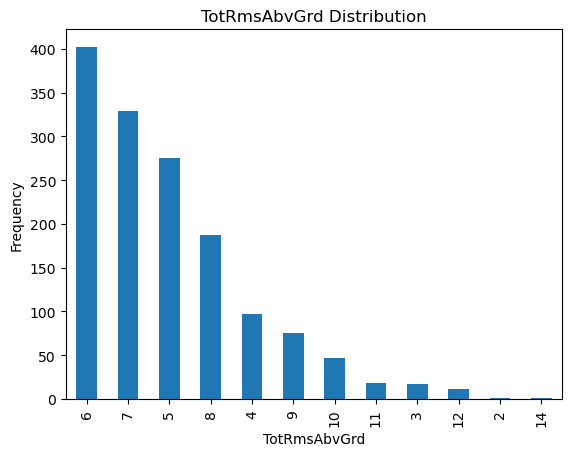

Frequency count for Functional:
Typ     1360
Min2      34
Min1      31
Mod       15
Maj1      14
Maj2       5
Sev        1
Name: Functional, dtype: int64



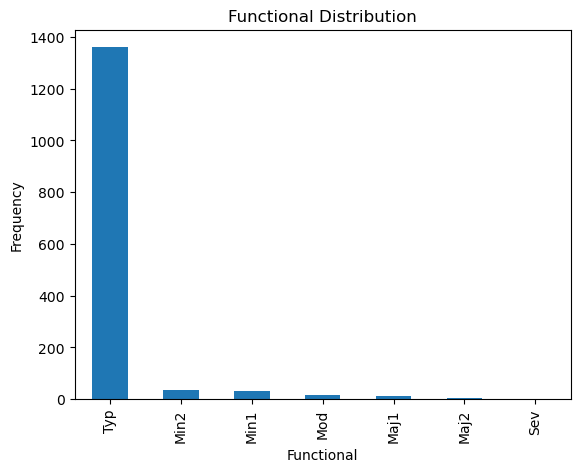

Frequency count for GarageType:
Attchd     951
Detchd     387
BuiltIn     88
Basment     19
CarPort      9
2Types       6
Name: GarageType, dtype: int64



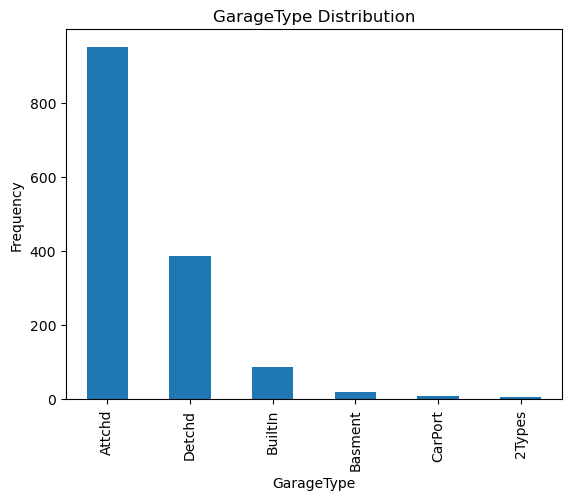

Frequency count for GarageFinish:
Unf    686
RFn    422
Fin    352
Name: GarageFinish, dtype: int64



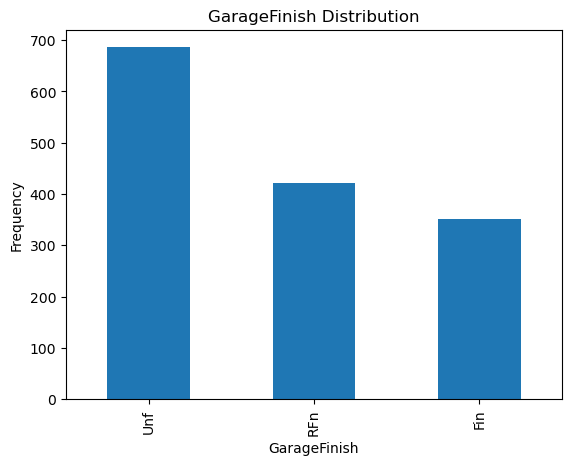

Frequency count for GarageQual:
TA    1392
Fa      48
Gd      14
Ex       3
Po       3
Name: GarageQual, dtype: int64



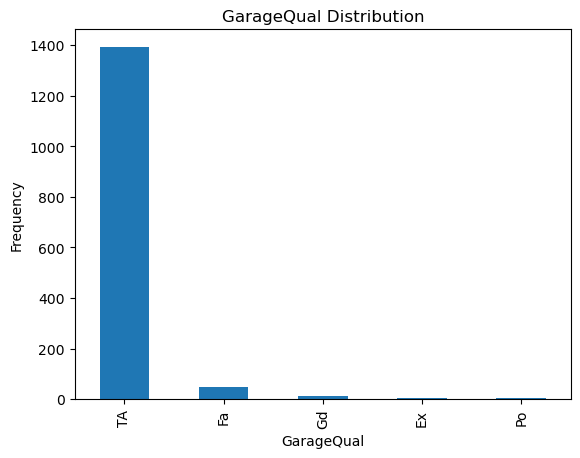

Frequency count for GarageCond:
TA    1407
Fa      35
Gd       9
Po       7
Ex       2
Name: GarageCond, dtype: int64



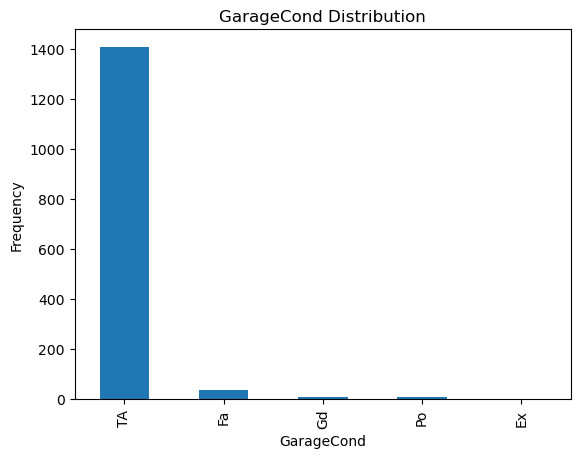

Frequency count for PavedDrive:
Y    1340
N      90
P      30
Name: PavedDrive, dtype: int64



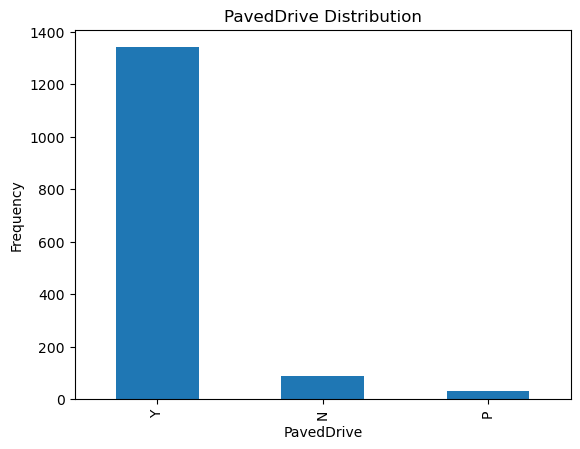

Frequency count for SaleType:
WD       1267
New       122
COD        43
ConLD       9
ConLI       5
ConLw       5
CWD         4
Oth         3
Con         2
Name: SaleType, dtype: int64



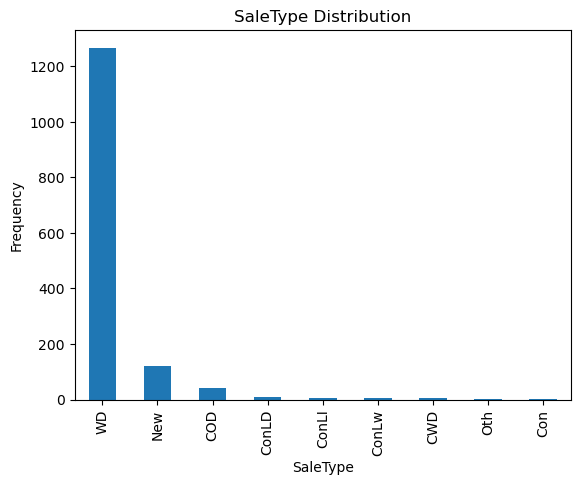

Frequency count for SaleCondition:
Normal     1198
Partial     125
Abnorml     101
Family       20
Alloca       12
AdjLand       4
Name: SaleCondition, dtype: int64



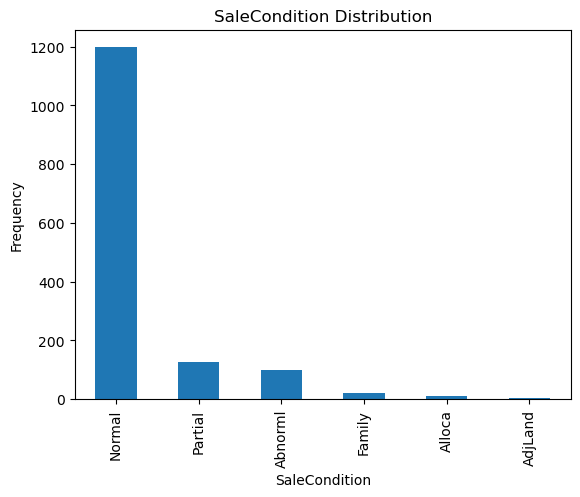

In [173]:
# Univariate analysis on categorical variables

for var in categorical_variables:
    # Frequency count
    freq_count = df[var].value_counts()
    print(f"Frequency count for {var}:")
    print(freq_count)
    print()
    
    # Bar plot
    plt.figure()
    df[var].value_counts().plot(kind='bar')
    plt.title(f"{var} Distribution")
    plt.xlabel(var)
    plt.ylabel("Frequency")
    plt.show()

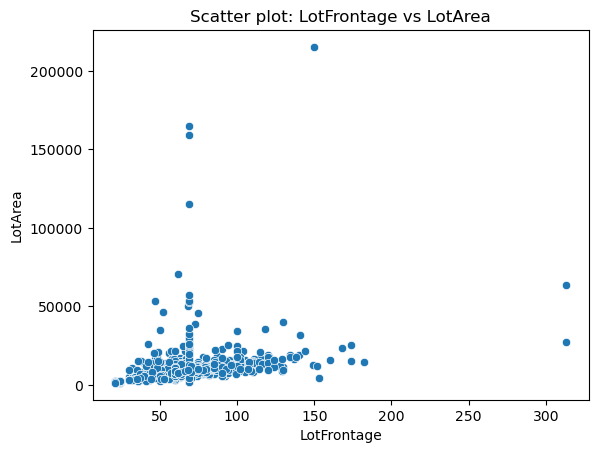

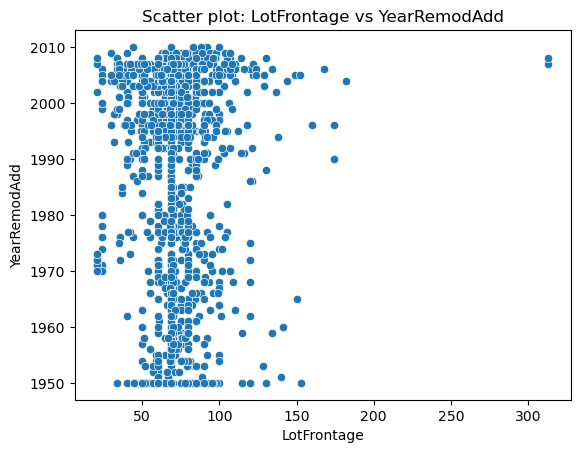

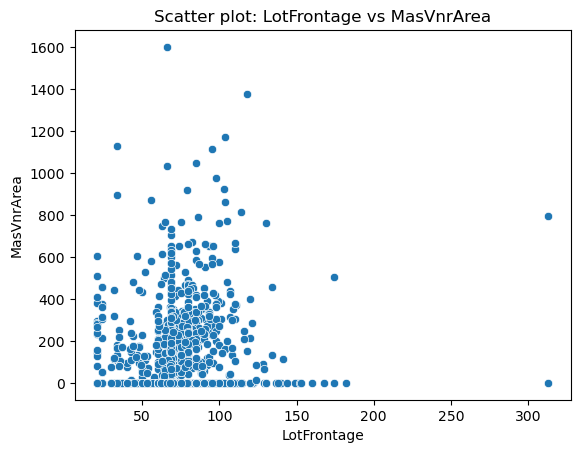

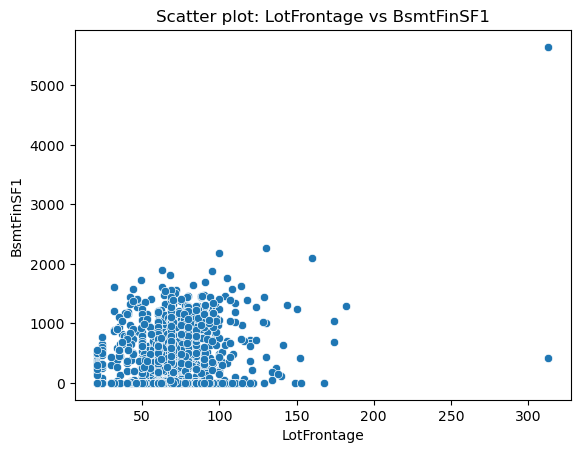

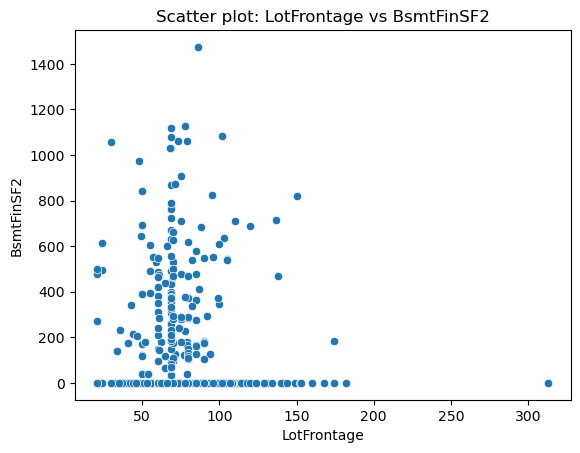

...

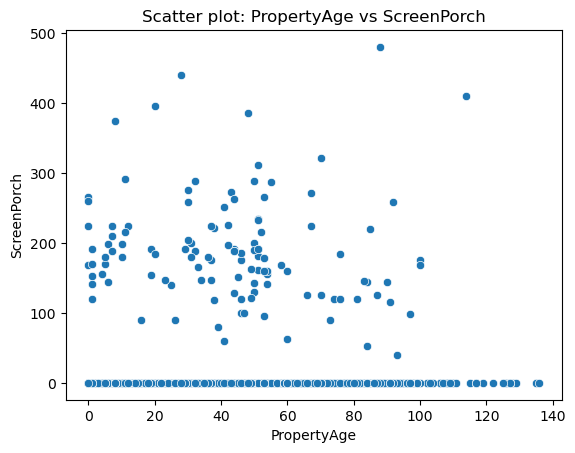

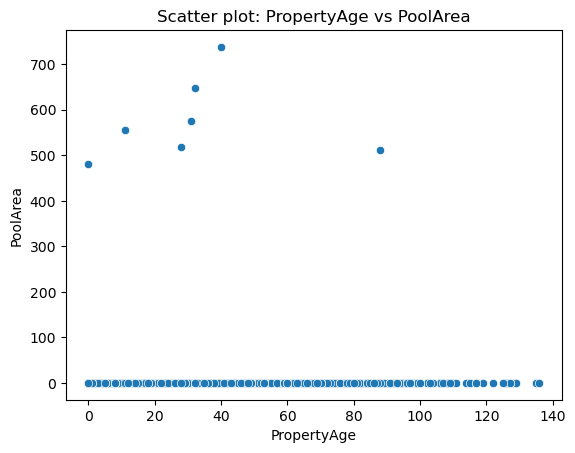

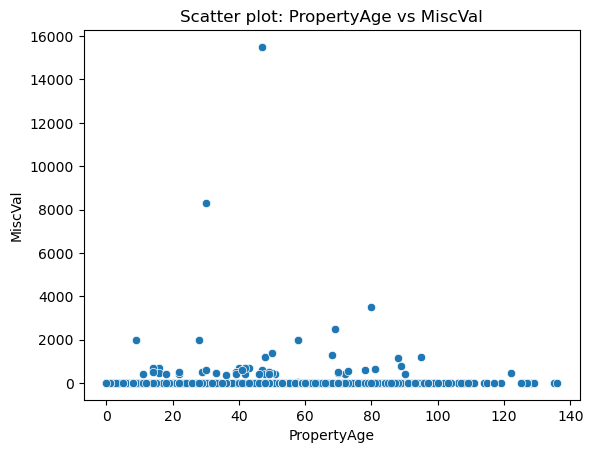

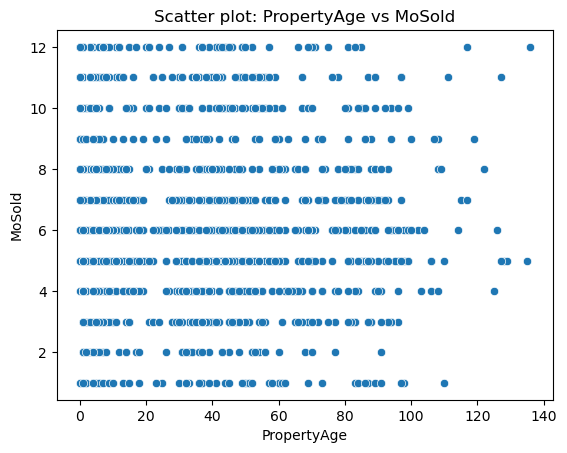

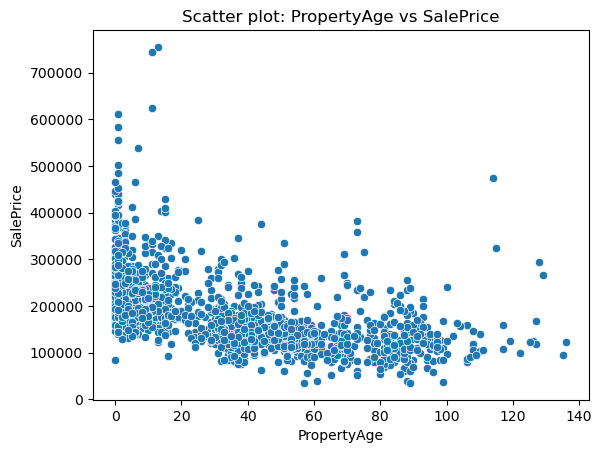

In [174]:
# Bivariate analysis
# Scatter plot: numeric vs numeric

for num_var1 in numeric_variables:
    for num_var2 in numeric_variables:
        if num_var1 != num_var2:
            plt.figure()
            sns.scatterplot(data=df, x=num_var1, y=num_var2)
            plt.title(f"Scatter plot: {num_var1} vs {num_var2}")
            plt.show()

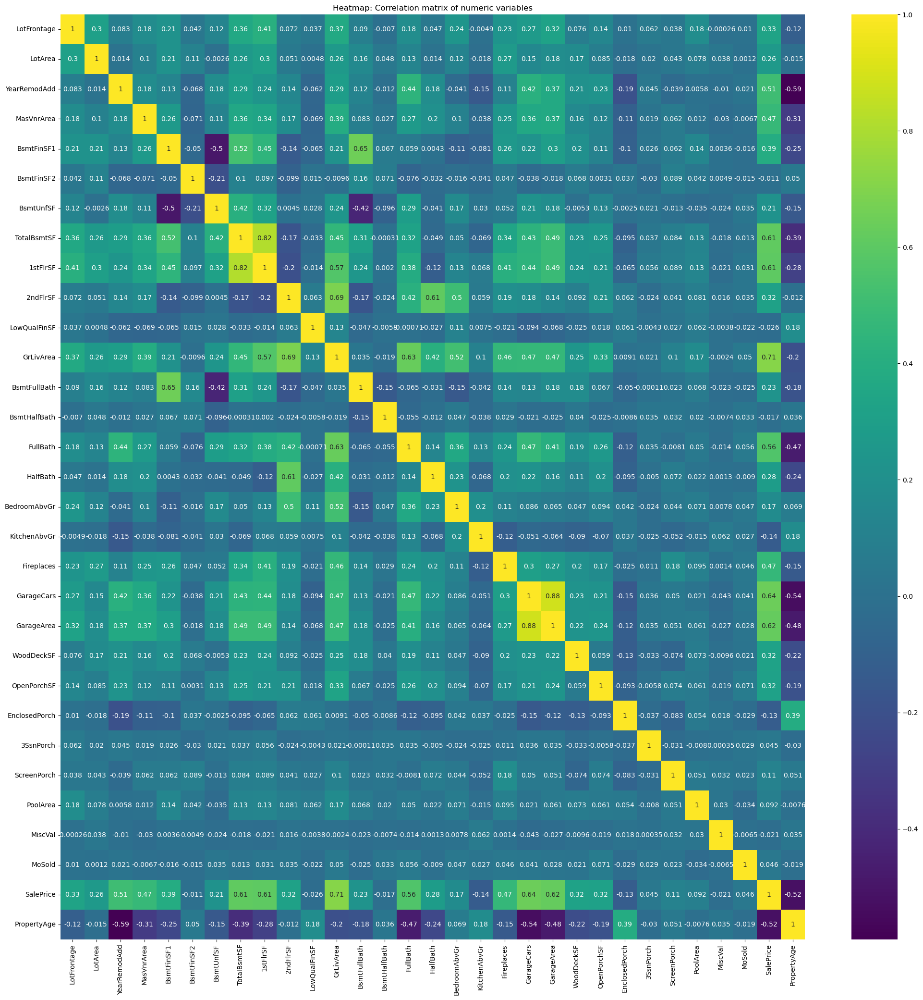

The top pairs of variables with the largest absolute correlations: 
 GarageArea    GarageCars      0.882475
1stFlrSF      TotalBsmtSF     0.819530
GrLivArea     SalePrice       0.708624
2ndFlrSF      GrLivArea       0.687501
BsmtFinSF1    BsmtFullBath    0.649212
GarageCars    SalePrice       0.640409
FullBath      GrLivArea       0.630012
GarageArea    SalePrice       0.623431
SalePrice     TotalBsmtSF     0.613581
2ndFlrSF      HalfBath        0.609707
1stFlrSF      SalePrice       0.605852
PropertyAge   YearRemodAdd    0.590360
1stFlrSF      GrLivArea       0.566024
FullBath      SalePrice       0.560664
GarageCars    PropertyAge     0.538727
PropertyAge   SalePrice       0.523350
BsmtFinSF1    TotalBsmtSF     0.522396
BedroomAbvGr  GrLivArea       0.521270
SalePrice     YearRemodAdd    0.507101
2ndFlrSF      BedroomAbvGr    0.502901
BsmtFinSF1    BsmtUnfSF       0.495251
1stFlrSF      GarageArea      0.489782
GarageArea    TotalBsmtSF     0.486665
              PropertyAge     0.47

In [175]:
# Bivariate analysis
# corelation analysis using heat map for numeric variables

# Subsetting the DataFrame for only numeric variables
numeric_df = df[numeric_variables]

# Computing the correlation matrix
corr_matrix = numeric_df.corr()

# Create a heatmap for the correlation matrix
plt.figure(figsize=(25, 25))
sns.heatmap(corr_matrix, annot=True, cmap='viridis')
plt.title("Heatmap: Correlation matrix of numeric variables")
plt.show()

#the following steps are performed to obtain the most corelated pairs

corr_abs_num = corr_matrix.abs() # to obtain the absolute correlation matrix

# creating a multi-level index of all possible pairs of variables and their correlations
corr_pairs_num = corr_abs_num.unstack().sort_values(ascending=False)

# excluding pairs with identical variables
corr_pairs_num = corr_pairs_num[(corr_pairs_num != 1) & (corr_pairs_num.index.get_level_values(0) != corr_pairs_num.index.get_level_values(1))]

# removing duplicates by keeping only pairs with variables in lexicographical order
corr_pairs_num = corr_pairs_num[corr_pairs_num.index.to_series().apply(lambda x: x[0] < x[1])]

# printing the top pairs of variables with the largest absolute correlations
print("The top pairs of variables with the largest absolute correlations: \n", corr_pairs_num.nlargest(35))

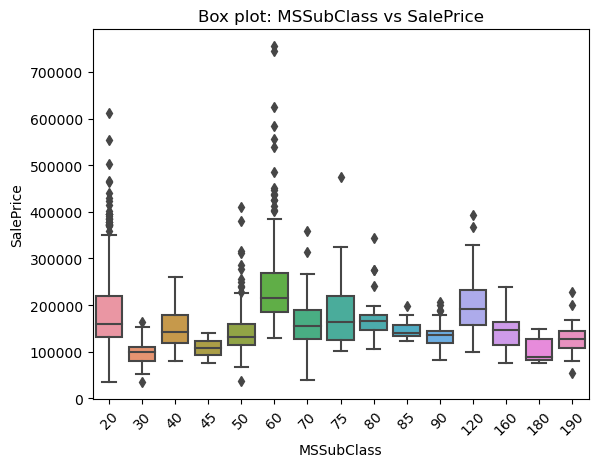

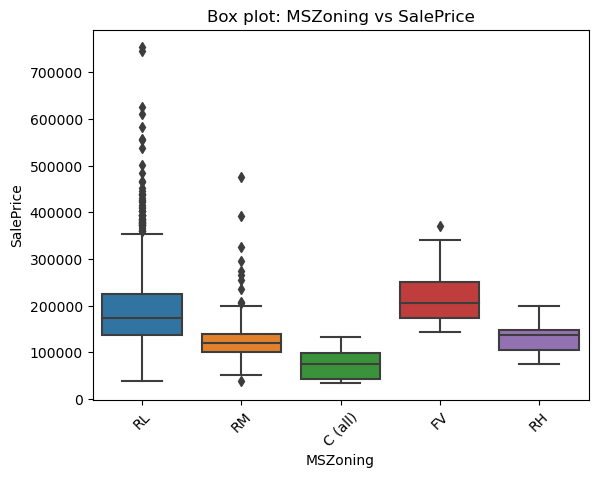

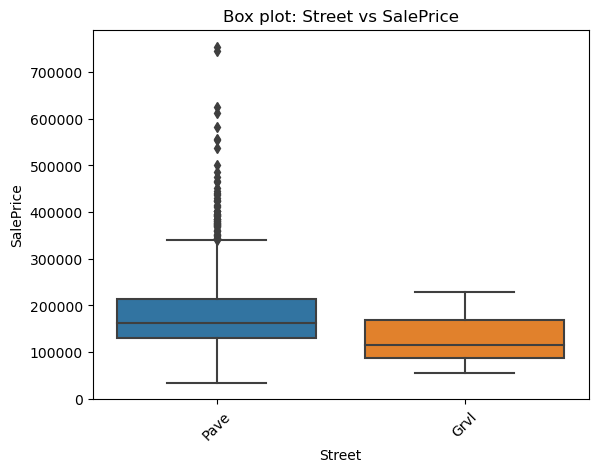

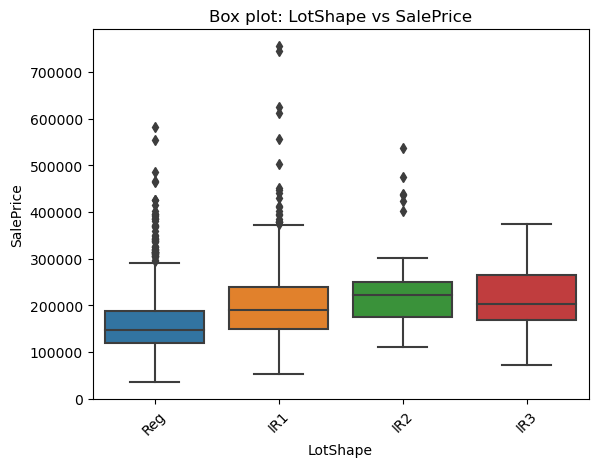

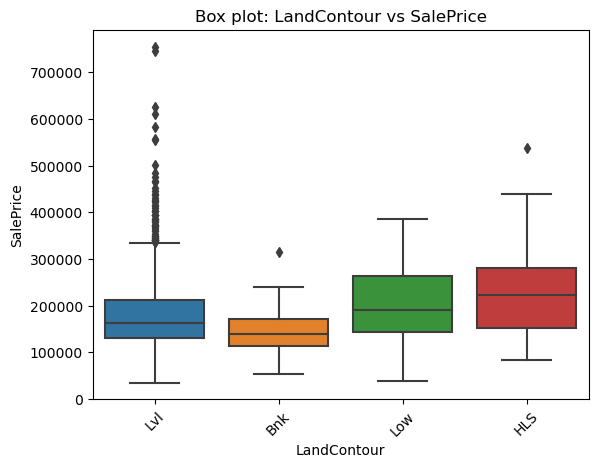

...

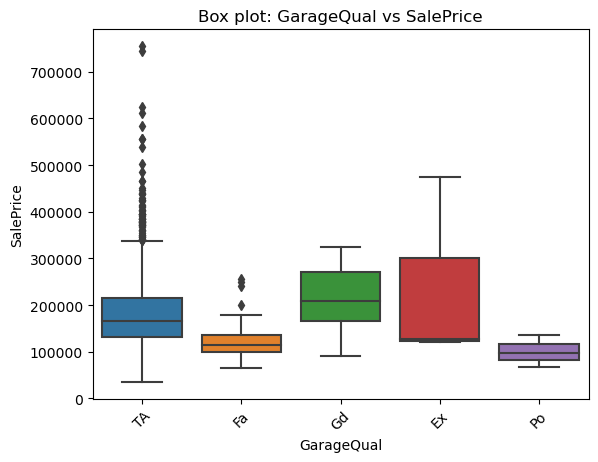

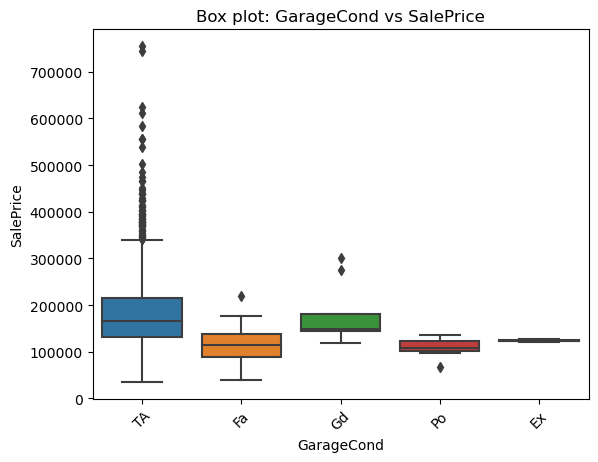

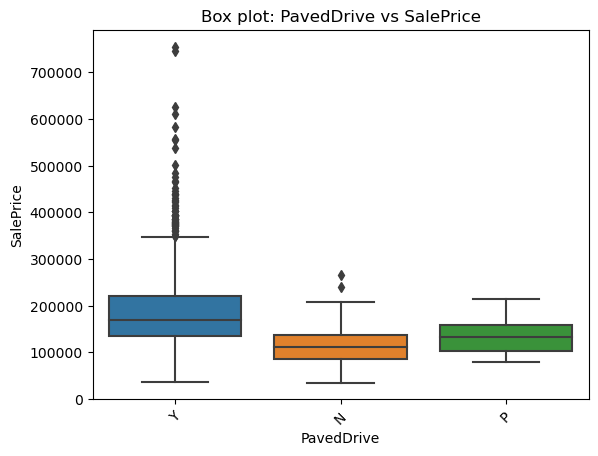

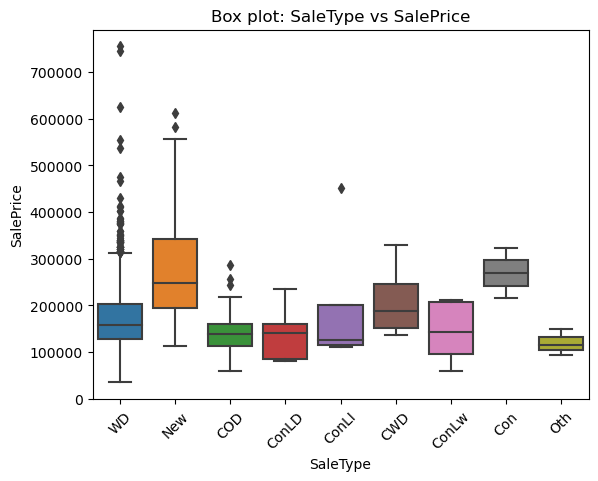

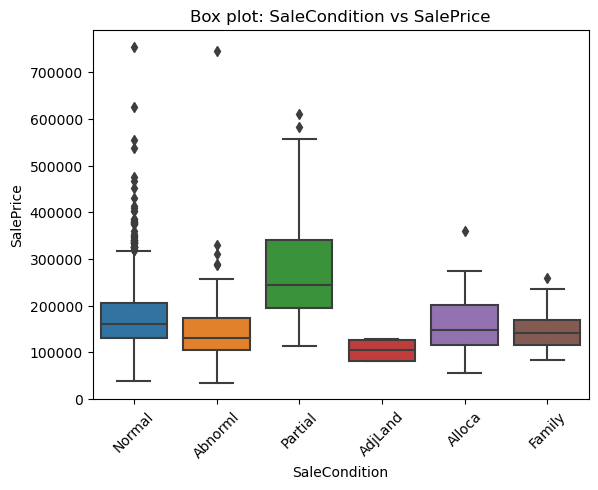

In [176]:
# Bivariate analysis
# Box plot: categorical vs numerical (our target variable 'SalePrice')

for cat_var in categorical_variables:
    plt.figure()
    ax = sns.boxplot(data=df, x=cat_var, y='SalePrice')
    plt.title(f"Box plot: {cat_var} vs SalePrice")
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45)
    plt.show()

**Based on the above visualizations, the following observations are noted:**
- SalePrice fluctuates extensively with 'MSSubClass' (i.e. the type of dwelling involved in the sale),  'Neighborhood', 'Condition1' & 'Condition1' (i.e. proximity to various conditions), HouseStyle (i.e. style of dwelling), roof material 'RoofMatl', exterior coverings ('Exterior1st' and 'Exterior2nd'), the total rooms above grade ('TotRmsAbvGrd'), and the type of sale ('SaleType').
- The median SalePrice is maximum for Floating Village Residential (FV) and mimimum for Commercial (C). Nonetheless, the saleprice distribution reaches the peak in case of Residential Low Density (RL)
- The median SalePrice is higher in case of paved street than in case of graveled street.
- The median SalePrice increases consistently from regular-shaped to moderately iregular-shaped property, decreasing slightly in case of irregular property.
- The median SalePrice is maximum for HLS property-flatness-type at hillsides, wherein there is a significant slope from side to side and mimimum in case of Banked type (BNK) with abrupt  significant rise from street grade to building
- The median SalePrice changes only moderately with the lot configuration and the land slope
- All records exhibit all public utilies except one with only electricity and gas, as conveyed by the 'Utilities' variable. This is also why we could drop the 'Utilities' variable, as it cannot be a significant predictor of the sale price
- The median SalePrice is higher in the cases of Townhouse-End-Unit ('1Fam') and Single-Family-Detached (TwnhsE) building types than those in other types of dwelling
- The median SalePrice fluctuates substantially across different styles of dwelling and is high for one-story and split-level type dwelling 
- While the median SalePrice increases consistently with the 'OverallQual' variable that captures the rates according to the overall material and finish of the house and the kitchen quality ('KitchenQual'), the median sale price does not exhibit a consistent linear increase in the saleprice with the overallcond (i.e. the rate of the overall condition of the house) 
- The median SalePrice is maximum for the shed 'RoofStyle' and minimum for the gambrel 'RoofStyle'
- The median SalePrice is maximum for the stone masonry veneer type ('MasVnrType') and minimum for brick common type ('BrkCmn')
- The median SalePrice is maximum for the excellent quality of the material on the exterior (ExterQual) and minimum for the fair quality, with no records for the poor quality
- The median SalePrice is maximum for the excellent present condition of the material on the exterior (ExterCond) and minimum for the poor present condition of the material on the exterior
- The median SalePrice is maximum for the Poured Contrete-type foundation and minimum for Slab type
- The median SalePrice is maximum for the Excellent (100+ inches) basement height, and minimum for the Fair (70-79 inches) level of 'BsmtQual'. No records in the dataset exhibit <70 inches basement height or any absence of basement
- The median SalePrice is maximum for good basement condition ('BsmtCond'), and minimum for poor basement condition featured by severe cracking, settling, or wetness
- The median SalePrice increases consistently with increasing exposure ('BsmtExposure') such as walkout or garden-level walls
- The median SalePrice exhibits moderate changes with the rating of basement finished area (BsmtFinType1 and BsmtFinType2)
- The median SalePrice is maximum for gas-forced warm-air-furnace-type heating and minimum for gravity furnace
- The median SalePrice is maximum for excellent heating quality ('HeatingQC') and condition and minimum for poor quality
- The median SalePrice is higher in the presence of central air conditioning than without air conditioning
- The median SalePrice is maximum for the electrical system equipped with standard Circuit Breakers & Romex and minimum for mixed-type electrical system
- The median SalePrice does not fluctuate significantly with the home functionality ('Functional')
- The median SalePrice is maximum for the BuiltIn-type garage location ('GarageType') and minimum for Car Port-type garage location
- The median SalePrice is maximum for finished interiors of garage ('GarageFinish') and minimum for unfinished
- The median SalePrice is maximum for good garage quality ('GarageQual') and typical/average garage condition ('GarageCond') and minimum for poor garage quality and fair garage condition
- The median SalePrice is maximum for paved driveway ('PavedDrive') and minimum for dirt/gravel paved driveway 
- The median SalePrice is maximum for partial-type sale condition ('SaleCondition') and minimum for adjoining-land-purchase-type sale condition

#### Handling of catagorical variables

In [177]:
# Separating categorical variables into two lists based on the number of unique values
categorical_variables_with_two_levels = []
categorical_variables_with_more_than_two_levels = []
for var in categorical_variables:
    num_unique_values = len(df[var].unique())
    if num_unique_values == 2:
        categorical_variables_with_two_levels.append(var)
    elif num_unique_values > 2:
        categorical_variables_with_more_than_two_levels.append(var)

print("Categorical variables with two levels:")
print(categorical_variables_with_two_levels)

print("\nCategorical variables with more than two levels:")
print(categorical_variables_with_more_than_two_levels)

Categorical variables with two levels:
['Street', 'Utilities', 'CentralAir']

Categorical variables with more than two levels:
['MSSubClass', 'MSZoning', 'LotShape', 'LandContour', 'LotConfig', 'LandSlope', 'Neighborhood', 'Condition1', 'Condition2', 'BldgType', 'HouseStyle', 'OverallQual', 'OverallCond', 'RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType', 'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2', 'Heating', 'HeatingQC', 'Electrical', 'KitchenQual', 'TotRmsAbvGrd', 'Functional', 'GarageType', 'GarageFinish', 'GarageQual', 'GarageCond', 'PavedDrive', 'SaleType', 'SaleCondition']


In [178]:
# Mapping the levels of binary catagorical variables to 0 and 1
df['Street'] = df['Street'].map({'Pave': 1, 'Grvl': 0})
df['Utilities'] = df['Utilities'].map({'AllPub': 1, 'NoSeWa': 0})
df['CentralAir'] = df['CentralAir'].map({'Y': 1, 'N': 0})

In [179]:
# Encoding non-binary catagorical variables using dummy variables
status = pd.get_dummies(df[categorical_variables_with_more_than_two_levels], drop_first=True) #  The information that is eliminated by dropping the first column is already implicit in the combination of the remaining n-1 column values 
df = pd.concat([df, status], axis = 1)  # Adding the encoded features to the original dataframe df
df.drop(categorical_variables_with_more_than_two_levels, axis=1, inplace=True) # As we have now created the dummies for the non-binary catagorical variables, we can drop the categorical_variables_with_more_than_two_levels 
df.head()

,LotFrontage,LotArea,Street,Utilities,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,...,SaleType_ConLI,SaleType_ConLw,SaleType_New,SaleType_Oth,SaleType_WD,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal,SaleCondition_Partial
0,65.0,8450,1,1,2003,196.0,706,0,150,856,...,0,0,0,0,1,0,0,0,1,0
1,80.0,9600,1,1,1976,0.0,978,0,284,1262,...,0,0,0,0,1,0,0,0,1,0
2,68.0,11250,1,1,2002,162.0,486,0,434,920,...,0,0,0,0,1,0,0,0,1,0
3,60.0,9550,1,1,1970,0.0,216,0,540,756,...,0,0,0,0,1,0,0,0,0,0
4,84.0,14260,1,1,2000,350.0,655,0,490,1145,...,0,0,0,0,1,0,0,0,1,0


In [180]:
# Displaying information pertaining to the updated dataframe after pre-processing the data so far
print("Dataframe shape:", df.shape)
print("\n Count of null values in each column of the dataframe \n",df.isnull().sum())   
print("\n Count of unique values in each column of the dataframe \n", df.nunique())
df.info()  # to take a look at the data types

Dataframe shape: (1460, 269)

 Count of null values in each column of the dataframe 
 LotFrontage              0
LotArea                  0
Street                   0
Utilities                0
YearRemodAdd             0
MasVnrArea               0
BsmtFinSF1               0
BsmtFinSF2               0
BsmtUnfSF                0
TotalBsmtSF              0
CentralAir               0
1stFlrSF                 0
2ndFlrSF                 0
LowQualFinSF             0
GrLivArea                0
BsmtFullBath             0
BsmtHalfBath             0
FullBath                 0
HalfBath                 0
BedroomAbvGr             0
KitchenAbvGr             0
Fireplaces               0
GarageCars               0
GarageArea               0
WoodDeckSF               0
OpenPorchSF              0
EnclosedPorch            0
3SsnPorch                0
ScreenPorch              0
PoolArea                 0
MiscVal                  0
MoSold                   0
SalePrice                0
PropertyAge            

#### Dividing into X (independent variables) and Y (dependent variable) sets for model building

In [181]:
y = df.pop('SalePrice')   # 'SalePrice' is our target variable
X = df
numeric_variables.remove('SalePrice')  # Updating the list of numeric variables in the dataframe

**Data splitting into Test and Train datasets** <br>
The data is split into 2 parts:

Train Dataset (on which model will be build and is ~70% of the total data)<br>
Test Dataset (on which build model will be tested and is ~30% of the total data)

In [182]:
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size = 0.7, test_size = 0.3, random_state = 100)
print ("Shape of X test dataset ", X_test.shape)
print ("Shape of X train dataset ", X_train.shape)
print ("Shape of Y test dataset ", y_test.shape)
print ("Shape of Y train dataset ", y_train.shape)

Shape of X test dataset  (438, 268)
Shape of X train dataset  (1021, 268)
Shape of Y test dataset  (438,)
Shape of Y train dataset  (1021,)


#### Feature Rescaling

In [183]:
print (numeric_variables)
# Checking the range of variables to see if scaling is required
df[numeric_variables].describe()

['LotFrontage', 'LotArea', 'YearRemodAdd', 'MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF', '2ndFlrSF', 'LowQualFinSF', 'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath', 'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'Fireplaces', 'GarageCars', 'GarageArea', 'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea', 'MiscVal', 'MoSold', 'PropertyAge']


,LotFrontage,LotArea,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,...,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,PropertyAge
count,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,...,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000
mean,69.863699,10516.828082,1984.865753,103.117123,443.639726,46.549315,567.240411,1057.429452,1162.626712,346.992466,...,472.980137,94.244521,46.660274,21.954110,3.409589,15.060959,2.758904,43.489041,6.321918,36.547945
std,22.027677,9981.264932,20.645407,180.731373,456.098091,161.319273,441.866955,438.705324,386.587738,436.528436,...,213.804841,125.338794,66.256028,61.119149,29.317331,55.757415,40.177307,496.123024,2.703626,30.250152
min,21.000000,1300.000000,1950.000000,0.000000,0.000000,0.000000,0.000000,0.000000,334.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000
25%,60.000000,7553.500000,1967.000000,0.000000,0.000000,0.000000,223.000000,795.750000,882.000000,0.000000,...,334.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,8.000000
50%,69.000000,9478.500000,1994.000000,0.000000,383.500000,0.000000,477.500000,991.500000,1087.000000,0.000000,...,480.000000,0.000000,25.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,35.000000
75%,79.000000,11601.500000,2004.000000,164.250000,712.250000,0.000000,808.000000,1298.250000,1391.250000,728.000000,...,576.000000,168.000000,68.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,54.000000
max,313.000000,215245.000000,2010.000000,1600.000000,5644.000000,1474.000000,2336.000000,6110.000000,4692.000000,2065.000000,...,1418.000000,857.000000,547.000000,552.000000,508.000000,480.000000,738.000000,15500.000000,12.000000,136.000000


It would be convenient at the time of model evaluation if the units of the coefficients obtained are all on the same scale. Therefore, we proceed with rescaling the numerical features, excluding the yes-no/0-1 and dummy variables (as we would otherwise lose their interpretability, should we scale them as well).

In [184]:
scaler = MinMaxScaler()   #instantiating an object of the MinMaxScaler class 
X_train[numeric_variables] = scaler.fit_transform(X_train[numeric_variables])
X_test[numeric_variables] = scaler.transform(X_test[numeric_variables])
X_train.head()

,LotFrontage,LotArea,Street,Utilities,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,...,SaleType_ConLI,SaleType_ConLw,SaleType_New,SaleType_Oth,SaleType_WD,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal,SaleCondition_Partial
210,0.157534,0.019306,1,1,0.000000,0.00,0.082920,0.0,0.169521,0.141408,...,0,0,0,0,1,0,0,0,1,0
318,0.236301,0.039403,1,1,0.716667,0.16,0.174876,0.0,0.154110,0.220458,...,0,0,0,0,1,0,0,0,1,0
239,0.106164,0.033981,1,1,0.000000,0.00,0.016655,0.0,0.274401,0.120295,...,0,0,0,0,1,0,0,0,1,0
986,0.130137,0.017931,1,1,0.883333,0.00,0.000000,0.0,0.207620,0.079378,...,0,0,0,0,1,0,0,0,1,0
1416,0.133562,0.046139,1,1,0.000000,0.00,0.000000,0.0,0.332620,0.127169,...,0,0,0,0,1,0,0,0,1,0


In [185]:
X_train[numeric_variables].describe()

,LotFrontage,LotArea,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,...,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,PropertyAge
count,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,...,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000
mean,0.166249,0.042143,0.582305,0.065306,0.079337,0.033980,0.241388,0.173773,0.184341,0.165943,...,0.332545,0.107894,0.089690,0.042275,0.007756,0.037559,0.003318,0.003143,0.480634,0.268883
std,0.075615,0.048226,0.343843,0.117088,0.082377,0.115907,0.192066,0.075145,0.092132,0.210799,...,0.150018,0.145254,0.126502,0.114501,0.063649,0.136582,0.053278,0.037314,0.249954,0.223312
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.133562,0.027923,0.283333,0.000000,0.000000,0.000000,0.092466,0.129787,0.116435,0.000000,...,0.231312,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.272727,0.058824
50%,0.164384,0.037531,0.733333,0.000000,0.069454,0.000000,0.197774,0.162357,0.165278,0.000000,...,0.338505,0.000000,0.047801,0.000000,0.000000,0.000000,0.000000,0.000000,0.454545,0.250000
75%,0.195205,0.046943,0.900000,0.098750,0.126152,0.000000,0.345034,0.215057,0.243056,0.352058,...,0.406206,0.196033,0.133843,0.000000,0.000000,0.000000,0.000000,0.000000,0.636364,0.397059
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


We note that the scaled variables now range between 0 and 1.

In [186]:
X_train.info(verbose=True)   # Ensuring that all are numeric-type features prior to model building

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1021 entries, 210 to 79
Data columns (total 268 columns):
 #    Column                 Dtype  
---   ------                 -----  
 0    LotFrontage            float64
 1    LotArea                float64
 2    Street                 int64  
 3    Utilities              int64  
 4    YearRemodAdd           float64
 5    MasVnrArea             float64
 6    BsmtFinSF1             float64
 7    BsmtFinSF2             float64
 8    BsmtUnfSF              float64
 9    TotalBsmtSF            float64
 10   CentralAir             int64  
 11   1stFlrSF               float64
 12   2ndFlrSF               float64
 13   LowQualFinSF           float64
 14   GrLivArea              float64
 15   BsmtFullBath           float64
 16   BsmtHalfBath           float64
 17   FullBath               float64
 18   HalfBath               float64
 19   BedroomAbvGr           float64
 20   KitchenAbvGr           float64
 21   Fireplaces             float64
 22 

#### In the following blocks of code, a linear regression model is built manually, and the optimal predictors obtained through iterative elimination by using both RFE and manual fine tuning. 
#### It must be noted that this is only an optional preliminary step to get an idea of the appropriateness of the performance of the regulatization-incorporated models built subsequently.

### Recursive Feature Selection-based Linear Regression Model Building 

We use the class LinearRegression from scikit-learn for building the model for its compatibility with the class RFE that will enable us to select features by recursively considering smaller and smaller sets of features.

In [187]:
lm = LinearRegression()   # creating an instance of the LinearRegression class
lm.fit(X_train, y_train)  # fitting the model to the training data. (The fit method is used to train the model by finding the optimal coefficients that minimize the sum of squared residuals between the predicted values and the actual target values.)

# running RFE seeking 14 selected output variables
rfe = RFE(estimator=lm, n_features_to_select=14)     # creating an instance of the RFE class         
rfe = rfe.fit(X_train, y_train)   # fitting the RFE model to the training data (The fit method is called to perform the feature selection process. It uses the specified linear regression model (lm) to train and evaluate the importance of each feature based on their coefficients.)

In [188]:
rfe_df = pd.DataFrame({'Predictor': X_train.columns, 'Select Status': rfe.support_, 'Ranking': rfe.ranking_})
rfe_df.sort_values(by='Ranking')

,Predictor,Select Status,Ranking
119,OverallQual_8,True,1
98,Condition2_PosN,True,1
141,RoofMatl_WdShngl,True,1
121,OverallQual_10,True,1
120,OverallQual_9,True,1
140,RoofMatl_WdShake,True,1
139,RoofMatl_Tar&Grv,True,1
138,RoofMatl_Roll,True,1
137,RoofMatl_Metal,True,1
231,TotRmsAbvGrd_14,True,1


In [189]:
col = X_train.columns[rfe.support_]
print ("The top 14 features selected", col)

The top 14 features selected Index(['GrLivArea', 'Condition2_PosN', 'OverallQual_8', 'OverallQual_9',
       'OverallQual_10', 'RoofMatl_CompShg', 'RoofMatl_Membran',
       'RoofMatl_Metal', 'RoofMatl_Roll', 'RoofMatl_Tar&Grv',
       'RoofMatl_WdShake', 'RoofMatl_WdShngl', 'Exterior1st_AsphShn',
       'TotRmsAbvGrd_14'],
      dtype='object')


### Iteration #1

In [190]:
X_train_rfe = X_train[col]   #Creating dataframe with RFE selected variables
X_train_sm = sm.add_constant(X_train_rfe) # Adding a constant variable
lr = sm.OLS(y_train, X_train_sm)  # creates an instance of the OLS class which represents the Ordinary Least Squares regression model 
lr_model = lr.fit() # fits the OLS model to the training data by estimating the coefficients of the linear regression model
lr_model.summary() #displays a summary of the various statistical metrics and information about the model

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              SalePrice   R-squared:                       0.755
Model:                            OLS   Adj. R-squared:                  0.751
Method:                 Least Squares   F-statistic:                     221.3
Date:                Mon, 31 Jul 2023   Prob (F-statistic):          3.07e-295
Time:                        21:40:33   Log-Likelihood:                -12246.
No. Observations:                1021   AIC:                         2.452e+04
Df Residuals:                    1006   BIC:                         2.460e+04
Df Model:                          14                                         
Covariance Type:            nonrobust                                         
=======================================================================================
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
const               -4.614e+05   4.25e+04    -10.858      0.000   -5.45e+05   -3.78e+05
GrLivArea            4.087e+05   1.47e+04     27.829      0.000     3.8e+05    4.37e+05
Condition2_PosN     -4.412e+05   4.14e+04    -10.652      0.000   -5.23e+05    -3.6e+05
OverallQual_8        7.662e+04   4089.114     18.738      0.000    6.86e+04    8.46e+04
OverallQual_9        1.481e+05   7933.347     18.666      0.000    1.33e+05    1.64e+05
OverallQual_10       2.127e+05   1.22e+04     17.423      0.000    1.89e+05    2.37e+05
RoofMatl_CompShg     5.418e+05   4.19e+04     12.944      0.000     4.6e+05    6.24e+05
RoofMatl_Membran     6.302e+05   5.75e+04     10.954      0.000    5.17e+05    7.43e+05
RoofMatl_Metal       5.982e+05   5.77e+04     10.368      0.000    4.85e+05    7.11e+05
RoofMatl_Roll         4.82e+05   5.73e+04      8.407      0.000    3.69e+05    5.95e+05
RoofMatl_Tar&Grv     5.312e+05   4.48e+04     11.870      0.000    4.43e+05    6.19e+05
RoofMatl_WdShake     5.374e+05   4.59e+04     11.697      0.000    4.47e+05    6.28e+05
RoofMatl_WdShngl     6.252e+05   4.55e+04     13.737      0.000    5.36e+05    7.15e+05
Exterior1st_AsphShn -7.674e+04   3.95e+04     -1.945      0.052   -1.54e+05     693.335
TotRmsAbvGrd_14     -1.127e+05   3.98e+04     -2.827      0.005   -1.91e+05   -3.45e+04
==============================================================================
Omnibus:                       59.567   Durbin-Watson:                   2.026
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              196.764
Skew:                           0.180   Prob(JB):                     1.88e-43
Kurtosis:                       5.120   Cond. No.                         140.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [191]:
vif = pd.DataFrame()
X = X_train_rfe
vif['Features'] = X.columns
vif['VIF'] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
0,GrLivArea,7.08
5,RoofMatl_CompShg,5.65
2,OverallQual_8,1.31
4,OverallQual_10,1.30
1,Condition2_PosN,1.09
3,OverallQual_9,1.09
10,RoofMatl_WdShake,1.06
11,RoofMatl_WdShngl,1.06
9,RoofMatl_Tar&Grv,1.04
13,TotRmsAbvGrd_14,1.02


### Iteration #2

In [192]:
col = list(col)
col.remove('GrLivArea') #Removing 'GrLivArea' owing to high VIF

X_train_rfe = X_train[col]   #Creating dataframe with RFE selected variables
X_train_sm = sm.add_constant(X_train_rfe) # Adding a constant variable
lr = sm.OLS(y_train, X_train_sm)  # creates an instance of the OLS class which represents the Ordinary Least Squares regression model 
lr_model = lr.fit() # fits the OLS model to the training data by estimating the coefficients of the linear regression model
lr_model.summary() #displays a summary of the various statistical metrics and information about the model

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              SalePrice   R-squared:                       0.566
Model:                            OLS   Adj. R-squared:                  0.561
Method:                 Least Squares   F-statistic:                     101.1
Date:                Mon, 31 Jul 2023   Prob (F-statistic):          2.75e-172
Time:                        21:40:34   Log-Likelihood:                -12537.
No. Observations:                1021   AIC:                         2.510e+04
Df Residuals:                    1007   BIC:                         2.517e+04
Df Model:                          13                                         
Covariance Type:            nonrobust                                         
=======================================================================================
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
const               -1.605e+05   5.46e+04     -2.938      0.003   -2.68e+05   -5.33e+04
Condition2_PosN     -2.922e+05   5.46e+04     -5.351      0.000   -3.99e+05   -1.85e+05
OverallQual_8        1.182e+05   5061.121     23.357      0.000    1.08e+05    1.28e+05
OverallQual_9        1.966e+05   1.03e+04     19.099      0.000    1.76e+05    2.17e+05
OverallQual_10       3.205e+05   1.54e+04     20.823      0.000     2.9e+05    3.51e+05
RoofMatl_CompShg      3.17e+05   5.46e+04      5.804      0.000     2.1e+05    4.24e+05
RoofMatl_Membran      4.02e+05   7.57e+04      5.309      0.000    2.53e+05    5.51e+05
RoofMatl_Metal       3.405e+05   7.57e+04      4.497      0.000    1.92e+05    4.89e+05
RoofMatl_Roll        2.975e+05   7.57e+04      3.929      0.000    1.49e+05    4.46e+05
RoofMatl_Tar&Grv     3.245e+05   5.87e+04      5.530      0.000    2.09e+05     4.4e+05
RoofMatl_WdShake     3.757e+05   6.06e+04      6.200      0.000    2.57e+05    4.95e+05
RoofMatl_WdShngl     4.284e+05   5.98e+04      7.166      0.000    3.11e+05    5.46e+05
Exterior1st_AsphShn -5.642e+04   5.25e+04     -1.075      0.282   -1.59e+05    4.65e+04
TotRmsAbvGrd_14      4.358e+04   5.25e+04      0.831      0.406   -5.94e+04    1.47e+05
==============================================================================
Omnibus:                      136.687   Durbin-Watson:                   1.947
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              267.990
Skew:                           0.808   Prob(JB):                     6.41e-59
Kurtosis:                       4.921   Cond. No.                         136.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [193]:
vif = pd.DataFrame()
X = X_train_rfe
vif['Features'] = X.columns
vif['VIF'] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
1,OverallQual_8,1.15
3,OverallQual_10,1.11
0,Condition2_PosN,1.08
2,OverallQual_9,1.04
10,RoofMatl_WdShngl,1.03
5,RoofMatl_Membran,1.00
6,RoofMatl_Metal,1.00
7,RoofMatl_Roll,1.00
8,RoofMatl_Tar&Grv,1.00
9,RoofMatl_WdShake,1.00


### Iteration #3

In [194]:
col.remove('Exterior1st_AsphShn') #elimination 'Exterior1st_AsphShn' owing to high p value
X_train_rfe = X_train[col]   #Creating dataframe with RFE selected variables
X_train_sm = sm.add_constant(X_train_rfe) # Adding a constant variable
lr = sm.OLS(y_train, X_train_sm)  # creates an instance of the OLS class which represents the Ordinary Least Squares regression model 
lr_model = lr.fit() # fits the OLS model to the training data by estimating the coefficients of the linear regression model
lr_model.summary() #displays a summary of the various statistical metrics and information about the model

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              SalePrice   R-squared:                       0.566
Model:                            OLS   Adj. R-squared:                  0.561
Method:                 Least Squares   F-statistic:                     109.4
Date:                Mon, 31 Jul 2023   Prob (F-statistic):          4.56e-173
Time:                        21:40:34   Log-Likelihood:                -12538.
No. Observations:                1021   AIC:                         2.510e+04
Df Residuals:                    1008   BIC:                         2.517e+04
Df Model:                          12                                         
Covariance Type:            nonrobust                                         
====================================================================================
                       coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------
const            -1.606e+05   5.46e+04     -2.939      0.003   -2.68e+05   -5.34e+04
Condition2_PosN  -2.922e+05   5.46e+04     -5.350      0.000   -3.99e+05   -1.85e+05
OverallQual_8     1.183e+05   5061.137     23.370      0.000    1.08e+05    1.28e+05
OverallQual_9     1.966e+05   1.03e+04     19.104      0.000    1.76e+05    2.17e+05
OverallQual_10    3.206e+05   1.54e+04     20.826      0.000     2.9e+05    3.51e+05
RoofMatl_CompShg   3.17e+05   5.46e+04      5.803      0.000     2.1e+05    4.24e+05
RoofMatl_Membran  4.021e+05   7.57e+04      5.310      0.000    2.54e+05    5.51e+05
RoofMatl_Metal    3.406e+05   7.57e+04      4.498      0.000    1.92e+05    4.89e+05
RoofMatl_Roll     2.976e+05   7.57e+04      3.930      0.000    1.49e+05    4.46e+05
RoofMatl_Tar&Grv  3.246e+05   5.87e+04      5.531      0.000    2.09e+05     4.4e+05
RoofMatl_WdShake  3.758e+05   6.06e+04      6.200      0.000    2.57e+05    4.95e+05
RoofMatl_WdShngl  4.284e+05   5.98e+04      7.166      0.000    3.11e+05    5.46e+05
TotRmsAbvGrd_14   4.365e+04   5.25e+04      0.832      0.406   -5.93e+04    1.47e+05
==============================================================================
Omnibus:                      136.509   Durbin-Watson:                   1.946
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              266.856
Skew:                           0.808   Prob(JB):                     1.13e-58
Kurtosis:                       4.914   Cond. No.                         136.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [195]:
vif = pd.DataFrame()
X = X_train_rfe
vif['Features'] = X.columns
vif['VIF'] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
1,OverallQual_8,1.15
3,OverallQual_10,1.11
0,Condition2_PosN,1.08
2,OverallQual_9,1.04
10,RoofMatl_WdShngl,1.03
5,RoofMatl_Membran,1.00
6,RoofMatl_Metal,1.00
7,RoofMatl_Roll,1.00
8,RoofMatl_Tar&Grv,1.00
9,RoofMatl_WdShake,1.00


### Iteration #4

In [196]:
col.remove('TotRmsAbvGrd_14') #elimination 'TotRmsAbvGrd_14' owing to high p value
X_train_rfe = X_train[col]   #Creating dataframe with RFE selected variables
X_train_sm = sm.add_constant(X_train_rfe) # Adding a constant variable
lr = sm.OLS(y_train, X_train_sm)  # creates an instance of the OLS class which represents the Ordinary Least Squares regression model 
lr_model = lr.fit() # fits the OLS model to the training data by estimating the coefficients of the linear regression model
lr_model.summary() #displays a summary of the various statistical metrics and information about the model

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              SalePrice   R-squared:                       0.565
Model:                            OLS   Adj. R-squared:                  0.561
Method:                 Least Squares   F-statistic:                     119.3
Date:                Mon, 31 Jul 2023   Prob (F-statistic):          5.75e-174
Time:                        21:40:34   Log-Likelihood:                -12538.
No. Observations:                1021   AIC:                         2.510e+04
Df Residuals:                    1009   BIC:                         2.516e+04
Df Model:                          11                                         
Covariance Type:            nonrobust                                         
====================================================================================
                       coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------
const            -1.606e+05   5.46e+04     -2.939      0.003   -2.68e+05   -5.33e+04
Condition2_PosN  -2.922e+05   5.46e+04     -5.351      0.000   -3.99e+05   -1.85e+05
OverallQual_8     1.182e+05   5059.988     23.365      0.000    1.08e+05    1.28e+05
OverallQual_9     1.966e+05   1.03e+04     19.103      0.000    1.76e+05    2.17e+05
OverallQual_10    3.206e+05   1.54e+04     20.826      0.000     2.9e+05    3.51e+05
RoofMatl_CompShg   3.17e+05   5.46e+04      5.804      0.000     2.1e+05    4.24e+05
RoofMatl_Membran  4.021e+05   7.57e+04      5.310      0.000    2.53e+05    5.51e+05
RoofMatl_Metal    3.406e+05   7.57e+04      4.498      0.000    1.92e+05    4.89e+05
RoofMatl_Roll     2.976e+05   7.57e+04      3.930      0.000    1.49e+05    4.46e+05
RoofMatl_Tar&Grv  3.246e+05   5.87e+04      5.531      0.000    2.09e+05     4.4e+05
RoofMatl_WdShake  3.758e+05   6.06e+04      6.201      0.000    2.57e+05    4.95e+05
RoofMatl_WdShngl  4.284e+05   5.98e+04      7.167      0.000    3.11e+05    5.46e+05
==============================================================================
Omnibus:                      135.846   Durbin-Watson:                   1.944
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              264.835
Skew:                           0.805   Prob(JB):                     3.10e-58
Kurtosis:                       4.905   Cond. No.                         136.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [197]:
vif = pd.DataFrame()
X = X_train_rfe
vif['Features'] = X.columns
vif['VIF'] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
1,OverallQual_8,1.15
3,OverallQual_10,1.11
0,Condition2_PosN,1.08
2,OverallQual_9,1.04
10,RoofMatl_WdShngl,1.03
5,RoofMatl_Membran,1.00
6,RoofMatl_Metal,1.00
7,RoofMatl_Roll,1.00
8,RoofMatl_Tar&Grv,1.00
9,RoofMatl_WdShake,1.00


Finally, after four iterations of linear regression model building, we obatin a fair R-squared value (56%) of the model, near zero p-values of the coefficients, and exceedingly low probability of f-value (5.75e-174), all of which indicate the suitability of the final model with 11 independent variables. 

In [198]:
X_test_new = X_test[X_train_rfe.columns]  # Retaining only the 11 variables in our model determined previously

X_test_sm = sm.add_constant(X_test_new)  # adding a constant
X_test_sm.head()

,const,Condition2_PosN,OverallQual_8,OverallQual_9,OverallQual_10,RoofMatl_CompShg,RoofMatl_Membran,RoofMatl_Metal,RoofMatl_Roll,RoofMatl_Tar&Grv,RoofMatl_WdShake,RoofMatl_WdShngl
1436,1.0,0,0,0,0,1,0,0,0,0,0,0
57,1.0,0,0,0,0,1,0,0,0,0,0,0
780,1.0,0,0,0,0,1,0,0,0,0,0,0
382,1.0,0,0,0,0,1,0,0,0,0,0,0
1170,1.0,0,0,0,0,1,0,0,0,0,0,0


In [199]:
y_pred_train = lr_model.predict(X_train_sm) # predicting on the train set
y_pred_test = lr_model.predict(X_test_sm)  # predicting on the test set

print ("Linear Regression Model Evaluation Metrics:")
metric = []
r2_train_lr = r2_score(y_train, y_pred_train)
print("R-squared value on the train set",r2_train_lr)
metric.append(r2_train_lr)

r2_test_lr = r2_score(y_test, y_pred_test)
print("R-squared value on the test set",r2_test_lr)
metric.append(r2_test_lr)

rss1_lr = np.sum(np.square(y_train - y_pred_train))
print("RSS on the train set",rss1_lr)
metric.append(rss1_lr)

rss2_lr = np.sum(np.square(y_test - y_pred_test))
print("RSS on the test set",rss2_lr)
metric.append(rss2_lr)

mse_train_lr = mean_squared_error(y_train, y_pred_train)
print("Mean Sq. Error on the train set",mse_train_lr)
metric.append(mse_train_lr**0.5)

mse_test_lr = mean_squared_error(y_test, y_pred_test)
print("Mean Sq. Error on the test set",mse_test_lr)
metric.append(mse_test_lr**0.5)

Linear Regression Model Evaluation Metrics:
R-squared value on the train set 0.5653995394199022
R-squared value on the test set 0.48973984348068167
RSS on the train set 2773054637075.611
RSS on the test set 1438276696919.518
Mean Sq. Error on the train set 2716018253.7469254
Mean Sq. Error on the test set 3283736750.9578037


#### While this linear regression model exhibits fair performance with only 11 independent variables, we notice considerable difference between the R-squared values on the train and test sets. Furthermore, the entire process has been time intensive and required manual intervention at each iteration. Next, we proceed with building the regression model with regularization using ridge and lasso techniques and compare their perfomances with that of the linear regression model based on RFE without any manual intervention.

In [200]:
print ("Shape of X test dataset ", X_test.shape)
print ("Shape of X train dataset ", X_train.shape)
print ("Shape of Y test dataset ", y_test.shape)
print ("Shape of Y train dataset ", y_train.shape)

Shape of X test dataset  (438, 268)
Shape of X train dataset  (1021, 268)
Shape of Y test dataset  (438,)
Shape of Y train dataset  (1021,)


In [201]:
# Defining the range of alpha values for ridge and lasso by generating a numpy array with 13 logarithmically spaced values 
alpha_range = np.logspace(-3, 3, 13)

'''Defining model dictionary where the keys are the names of the models and 
the values are the instances of the GridSearchCV estimator initialized with Ridge and Lasso models
the param_grid set to search over the range of alpha values. 
GridSearchCV performs a grid search over the provided parameter values (in this case, alpha values) 
and selects the best one based on cross-validation score.'''

models_to_fit = {
    'Ridge': GridSearchCV(Ridge(), {'alpha': alpha_range}),
    'Lasso': GridSearchCV(Lasso(), {'alpha': alpha_range})
}

# Fitting each model to the training data and prints the best alpha value for each
for name, model in models_to_fit.items():
    model.fit(X_train, y_train)
    print(f"Best alpha for {name}: ", model.best_params_)

#Defining models with the optimal alpha
'''Initializing a dictionary, where the keys are the names of the models ("Linear", "Ridge", "Lasso") 
and the values are the instances of the respective models initialized with the optimal alpha values 
obtained from the grid search above. '''
#The linear regression model doesn't need alpha, hence it is initialized without any arguments.


models = {
    'Linear': LinearRegression(),
    'Ridge': Ridge(alpha=models_to_fit['Ridge'].best_params_['alpha']),
    'Lasso': Lasso(alpha=models_to_fit['Lasso'].best_params_['alpha'])
}



'''creating a dictionary of pipelines, where each pipeline consists of a feature selection step 
(using RFE - Recursive Feature Elimination) and a model fitting step. 
RFE is a feature selection method that fits a model and removes the weakest feature (or features) 
until the specified number of features is reached.'''

pipelines = {
    name: Pipeline([
        ('feature_selection', RFE(estimator=model, n_features_to_select=9)),
        ('m', model)
    ]) for name, model in models.items()
}

performance_table = pd.DataFrame()

'''This loop iterates over the dictionary pipelines, fits each pipeline to the training data, 
creates a summary table for each model that shows the estimated coefficients, their standard errors, 
t-values, and p-values. Additionally, it evaluates the performance of the model on both the training 
and test sets, computes the Residual Sum of Squares (RSS), R-squared, Adjusted R-squared, Mean Squared Error (MSE),
and Negative Root Mean Squared Error (NRMSE) for each model and saves the results into a performance 
table.'''

for name, pipeline in pipelines.items():
    pipeline.fit(X_train, y_train)
    
    # Creating the transformed dataset
    Xt_train = pipeline.named_steps['feature_selection'].transform(X_train)
    
    # Adding the intercept (constant term)
    intercept = pipeline.named_steps['m'].intercept_
    
    summary_table = pd.DataFrame()
    summary_table = summary_table.append({
        'Regression': name,
        'Variables': 'Intercept',
        'Coef.': intercept,
        'Std.E.': np.nan,
        '𝒕': np.nan,
        '𝒑': np.nan}, ignore_index=True)

    for i in range(Xt_train.shape[1]):
        coef = pipeline.named_steps['m'].coef_[i]
        std_error = np.sqrt(np.diagonal(np.linalg.pinv(Xt_train.T.dot(Xt_train))))[i]
        t_val = coef/std_error
        p_val = (1 - stats.t.cdf(abs(t_val), y_train.shape[0] - Xt_train.shape[1] - 1)) * 2
        
        summary_table = summary_table.append({
            'Regression': name,
            'Variables': X_train.columns[pipeline.named_steps['feature_selection'].support_][i],
            'Coef.': coef,
            'Std.E.': std_error,
            '𝒕': t_val,
            '𝒑': p_val}, ignore_index=True)

    print(f'\n{name} Regression Summary Table')
    print(summary_table[['Regression', 'Variables', 'Coef.', 'Std.E.', '𝒕', '𝒑']])
    
    # Evaluating the performance on train and test separately
    for dataset, dataset_name in [(X_train, 'Train'), (X_test, 'Test')]:
        y_true = y_train if dataset_name == 'Train' else y_test
        y_pred = pipeline.predict(dataset)
        
        rss = np.sum((y_pred - y_true)**2)
        r2 = r2_score(y_true, y_pred)
        mse = mean_squared_error(y_true, y_pred)
        nrmse = -np.sqrt(mse)
        
        n = len(dataset)
        k = pipeline.named_steps['feature_selection'].get_support().sum()  # Obtaining the number of selected features
        adj_r2 = 1 - ((1 - r2) * (n - 1) / (n - k - 1))  # computing the Adjusted R²
        
        performance_table = performance_table.append({
            'Regression': name,
            'Dataset': dataset_name,
            'RSS': rss,
            'R2': r2,
            'Adj. R2': adj_r2,
            'MSE': mse,
            'NRMSE': nrmse}, ignore_index=True)

performance_table = performance_table[['Regression', 'Dataset', 'RSS', 'R2', 'Adj. R2', 'MSE', 'NRMSE']]
print('\nPerformance Table')
print(performance_table)

Best alpha for Ridge:  {'alpha': 10.0}
Best alpha for Lasso:  {'alpha': 316.22776601683796}

Linear Regression Summary Table
  Regression         Variables          Coef.    Std.E.             𝒕    𝒑
0     Linear         Intercept -432198.699914       NaN           NaN  NaN
1     Linear         GrLivArea  592198.699914  0.309286  1.914729e+06  0.0
2     Linear   Condition2_PosN -355737.889993  1.018115 -3.494083e+05  0.0
3     Linear  RoofMatl_CompShg  490415.627141  0.070744  6.932234e+06  0.0
4     Linear  RoofMatl_Membran  568436.632770  1.001510  5.675796e+05  0.0
5     Linear    RoofMatl_Metal  549610.443774  1.000534  5.493171e+05  0.0
6     Linear     RoofMatl_Roll  400551.798824  1.003871  3.990071e+05  0.0
7     Linear  RoofMatl_Tar&Grv  459775.267667  0.414419  1.109445e+06  0.0
8     Linear  RoofMatl_WdShake  460251.087633  0.512648  8.977910e+05  0.0
9     Linear  RoofMatl_WdShngl  621957.427639  0.511595  1.215723e+06  0.0

Ridge Regression Summary Table
  Regression      

Here are the implications of the results obtained here:

1. **Best alpha for Ridge: {'alpha': 10.0}**: The optimal regularization strength for Ridge regression, determined through hyperparameter tuning, is 10.0.

2. **Best alpha for Lasso: {'alpha': 316.23}**: The optimal regularization strength for Lasso regression, determined through hyperparameter tuning, is approximately 316.23.

3. **Linear Regression Summary Table**: This table shows the coefficients of the variables in the linear regression model. Each variable's importance is represented by its coefficient. A positive coefficient indicates a positive relationship with the target variable, while a negative coefficient indicates a negative relationship. The t-value and the p-value help in understanding the statistical significance of the coefficients. A low p-value (typically ≤ 0.05) indicates that we can reject the null hypothesis, which means that the variable is statistically significant.

4. **Ridge Regression Summary Table**: This table presents all the details for the Ridge regression model similar to that shown for the Linear Regression table. The difference lies in the fact that we apply L2 regularization in this case, which prevents overfitting by restricting the coefficients of the model, thereby keeping them small.

5. **Lasso Regression Summary Table**: This is laregely similar to the previous tables; however, the Lasso regression model uses L1 regularization, which not only prevents overfitting but can also excludes unimportant variables by making their coefficients zero.

The nine variables in the summary tables are the most significant predictors of the target sale price. 
The goodness of fit for these variables and how well they describe the price of a house can be assessed from the R-squared (R2) and Adjusted R-squared (Adj. R2) values. 

For the Linear model, the R2 is 0.553 and Adj. R2 is 0.549 for the training dataset, and 0.452 and 0.441 for the test dataset, respectively. This suggests that about 55.3% and 45.2% of the variance in the house prices can be explained by the model on the training and test datasets, respectively. The substantial difference between the R2 values on the test and train data indicates overfitting.

For the Ridge model, the R2 is 0.726 and Adj. R2 is 0.723 for the training dataset, and 0.730 and 0.724 for the test dataset, respectively. This suggests that about 72.6% and 73.0% of the variance in the house prices can be explained by the model on the training and test datasets, respectively.

For the Lasso model, the R2 is 0.798 and Adj. R2 is 0.796 for the training dataset, and 0.804 and 0.800 for the test dataset, respectively. This suggests that about 79.8% and 80.4% of the variance in the house prices can be explained by the model on the training and test datasets, respectively. The metrics for training and testing datasets are relatively close, which is a good sign of generalizability.

Since there is no significant difference between the R2 values on the test and train data, we can say that the rigde and lasso models have addressed the issue of overfitting through regularization.

6. **Performance Table**: This table compares the performance of the three regression models (Linear, Ridge, and Lasso) using various metrics such as Residual Sum of Squares (RSS), R-squared (R2), Adjusted R-squared (Adj. R2), Mean Squared Error (MSE), and Negative Root Mean Squared Error (NRMSE). 

**Lower values of RSS, MSE, and NRMSE and higher values of R2 and Adj. R2 indicate better model performance.**

- From the output, it appears that the Lasso Regression model exhibits the best performance, as it has the lowest RSS, MSE, and NRMSE and the highest R2 and Adj. R2 scores on both the training and testing datasets. <br>
**Equation for the lasso regression model:
y = 85725.947736 + 30512.222719 * YearRemodAdd + 216326.777645 * GrLivArea + 50927.778547 * Fireplaces + 59249.790586 * GarageCars - 56528.061292 * PropertyAge + 39303.245706 * Neighborhood_NoRidge + 43767.665578 * OverallQual_8 + 102387.775077 * OverallQual_9 + 120041.591278 * OverallQual_10** <br>

- The second-best performance is exhibited by Ridge Regression. <br>
**Equation for the ridge regression model:
y = 38067.416630 + 78063.967037 * TotalBsmtSF + 78907.907443 * 1stFlrSF + 110244.492710 * GrLivArea + 79131.268827 * FullBath - 66630.090519 * KitchenAbvGr + 105322.453394 * GarageCars + 63556.012140 * Neighborhood_NoRidge + 82441.576572 * OverallQual_9 + 72320.519184 * OverallQual_10** <br>

- The performance of linear regression is inferior to both ridge and lasso and the difference in the R2 scores on the test and train sets indicate considerable overfitting. <br>
**Equation for the linear regression model:
y = -432198.699914 + 592198.699914 * GrLivArea - 355737.889993 * Condition2_PosN + 490415.627141 * RoofMatl_CompShg + 568436.632770 * RoofMatl_Membran + 549610.443774 * RoofMatl_Metal + 400551.798824 * RoofMatl_Roll + 459775.267667 * RoofMatl_Tar&Grv + 460251.087633 * RoofMatl_WdShake + 621957.427639 * RoofMatl_WdShngl**


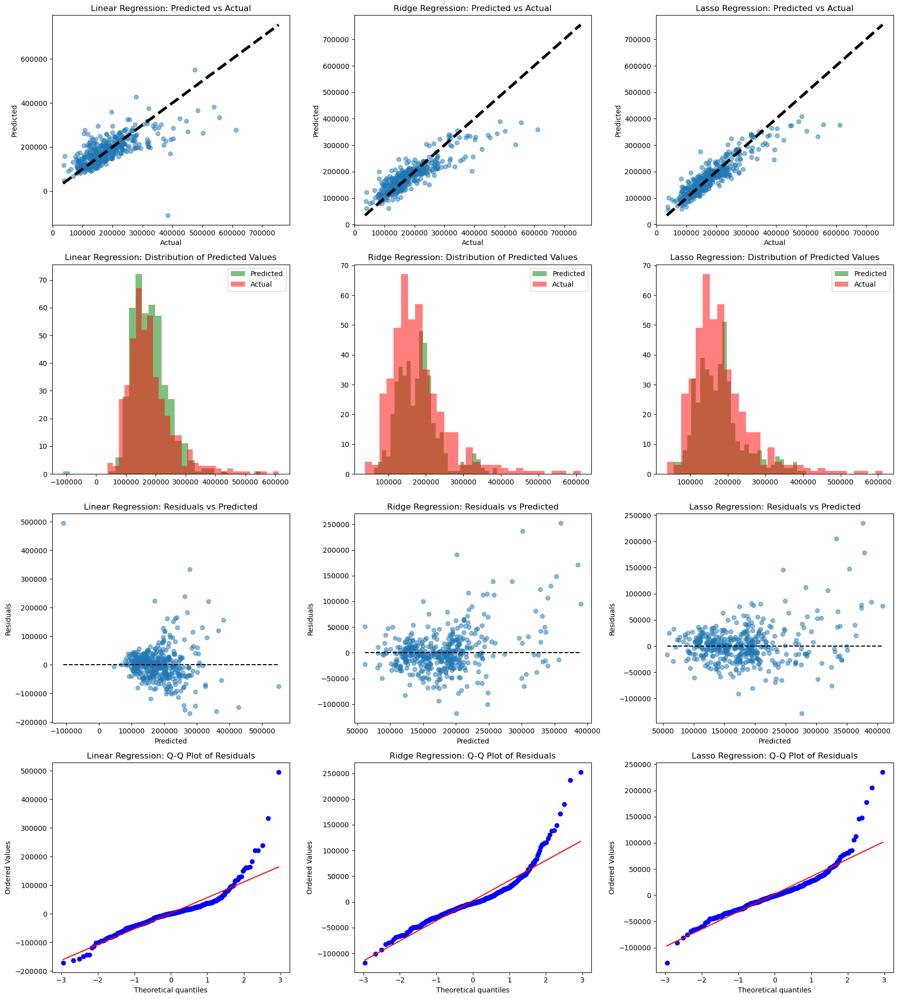

In [202]:
fig, axes = plt.subplots(nrows=4, ncols=3, figsize=(18, 20))

for idx, (name, pipeline) in enumerate(pipelines.items()):

    # Plotting regression line against actual data
    y_pred = pipeline.predict(X_test) #uses the current pipeline model to make predictions on the test set, and stores the predictions in y_pred
    axes[0, idx].scatter(y_test, y_pred, alpha=0.5)
    axes[0, idx].plot([y.min(), y.max()], [y.min(), y.max()], 'k--', lw=4)
    axes[0, idx].set_xlabel('Actual')
    axes[0, idx].set_ylabel('Predicted')
    axes[0, idx].set_title(f'{name} Regression: Predicted vs Actual')

    # Plotting the distribution of predicted values
    axes[1, idx].hist(y_pred, bins=30, alpha=0.5, color='g', label='Predicted')
    axes[1, idx].hist(y_test, bins=30, alpha=0.5, color='r', label='Actual')
    axes[1, idx].legend(loc='upper right')
    axes[1, idx].set_title(f'{name} Regression: Distribution of Predicted Values')

    # Plot of residuals vs predicted values
    residuals = y_test - y_pred
    axes[2, idx].scatter(y_pred, residuals, alpha=0.5)
    axes[2, idx].hlines(0, xmin=min(y_pred), xmax=max(y_pred), colors='k', linestyles='dashed')
    axes[2, idx].set_xlabel('Predicted')
    axes[2, idx].set_ylabel('Residuals')
    axes[2, idx].set_title(f'{name} Regression: Residuals vs Predicted')
    
    # QQ plot of residuals
    stats.probplot(residuals, dist="norm", plot=axes[3, idx])
    axes[3, idx].set_title(f'{name} Regression: Q-Q Plot of Residuals')

plt.tight_layout()
plt.show()

**The first row of plots visually presents the evaluation of the models' performance by comparing the predicted values with the actual values.** <br>
If the points cluster closely around the line, then the model's predictions are close to the actual values and the model is said to be performing well. Points scattered far from the line indicate large discrepancies between the predicted and actual values, suggesting poor model performing.

**The second row of plots visually presents the distribution of predicted values as a histogram to identify systematic bias in the models' prediction, not merely in terms of individual predictions but in terms of the overall distribution of values.** <br>
If the predicted and actual histograms align well, it suggests that the model is accurately capturing the underlying distribution of the target variable.
If the predicted distribution is skewed compared to the actual distribution, or if it fails to capture the shape of the actual distribution, then the model may be systematically over- or under-estimating the target variable. 


**The third row of plots presents the plot of residuals versus predicted values for assessment of the assumption of homoscedasticity.** <br>
Any point on the horizontal line at zero implies the prediction is exactly correct for that observation. If the residuals are randomly and evenly scattered around the horizontal line, the the assumption of homoscedasticity is validated. A pattern noted in the residuals is an indication of heteroscedasticity, which means the model's performance varies across the range of the predictor variable, suggesting that a linear model might not be the best fit for the data.


**The fourth row of plots presents the Q-Q plot of the residuals for checking whether the residuals are normally distributed.** <br>
If the residuals are normally distributed, the points on the Q-Q plot roughly lie along a straight diagonal line from the bottom left to the top right of the plot. 
Any substantial deviations from this straight line indicate departure from normality. This could be due to outliers in the data or the data might be heavy-tailed or light-tailed.
Points curving upwards away from the diagonal line suggest that the tails of the residual distribution are heavier than those of the normal distribution (the residuals have more large values than would be expected if they truly had an underlying normal distribution).
Points curving downwards towards the line suggest the tails are lighter than those of the normal distribution (there are fewer large residuals than we would expect if they truly had an underlying normal distribution).

### Subjective questions & answers and related codes

The following QnA have been provided separately as a pdf file. I have provided the following in this notebook because certain questions required compilation in this environment.

Question 1
What is the optimal value of alpha for ridge and lasso regression? What will be the changes in the model if you choose double the value of alpha for both ridge and lasso? What will be the most important predictor variables after the change is implemented?

The optimal alpha values for Ridge and Lasso were found to be 10 and 316.23, respectively.

The alpha parameter in Ridge and Lasso regressions is a regularization term that controls the magnitude of the coefficients in the model. Regularization is an approach to prevent overfitting by adding a penalty term to the loss function that the model seeks to minimize.

For Ridge regression (L2 regularization), the regularization term is the sum of the squares of the coefficients, multiplied by alpha. If we increase alpha, the penalty for large coefficients becomes more severe. This means the model will be less likely to assign a large weight to any single feature, potentially leading to less overfitting. However, if alpha is extremely high, the model might become exceedingly simple and underfit the data, leading to higher bias.

For Lasso regression (L1 regularization), the regularization term is the sum of the absolute values of the coefficients, multiplied by alpha. Increasing alpha in Lasso regression has the same general effect of reducing overfitting. However, a distinctive feature of Lasso regression is that it can shrink some coefficients to exactly zero, effectively performing feature selection. If we increase alpha substantially, an increasing number of features might be "lassoed" out of the model, rendering it overly simple and again leading to underfitting.

In general, if we were to choose double the value of alpha for both Ridge and Lasso regression the model would become more regularized, reducing the risk of overfitting. Furthermore, the coefficients of the model would generally become smaller. In the case of Lasso, some coefficients might become exactly zero, reducing the complexity of the model. The model might become less sensitive to changes in individual features, which can be beneficial should we expect the model to be robust to small changes in the input data. However, if alpha is increased substantially, the model might become exceedingly simple, and its predictive performance on both the training set and the test set could decrease, resulting in underfitting.

In [203]:
#What will be the most important predictor variables after the change is implemented?
#Since the best alpha for Ridge was 10 and for Lasso was 316.23, we will use 20 for Ridge and 632.46 for Lasso.

pd.set_option('display.max_rows', None)

alpha_ridge = 10 * 2
alpha_lasso = 316.23 *2 

models = {'Ridge': Ridge(alpha=alpha_ridge), 'Lasso': Lasso(alpha=alpha_lasso)}

for name, model in models.items():
    model.fit(X_train, y_train)
    
    # Creating a DataFrame to store the model coefficients
    coef_df = pd.DataFrame()
    coef_df['Variable'] = X_train.columns  # Ensuring all features are included
    coef_df['Coefficient'] = model.coef_
    
    # Filtering the coefficients that are exactly zero (for Lasso)
    coef_df = coef_df[coef_df['Coefficient'] != 0]
    
    # Sorting the DataFrame by the absolute value of the coefficients
    coef_df = coef_df.reindex(coef_df.Coefficient.abs().sort_values(ascending=False).index)
    
    print(f'\n{name} Regression with alpha={model.alpha}')
    print('Most important predictors after doubling the alpha value:')
    print(coef_df)



Ridge Regression with alpha=20
Most important predictors after doubling the alpha value:
                  Variable   Coefficient
228        TotRmsAbvGrd_10  31411.124004
77    Neighborhood_NoRidge  30437.572472
121         OverallQual_10  29223.799243
14               GrLivArea  28852.825893
12                2ndFlrSF  27659.579475
120          OverallQual_9  25411.504777
17                FullBath  25288.228965
22              GarageCars  24166.736710
21              Fireplaces  21851.055221
11                1stFlrSF  21650.599839
187            BsmtQual_Gd -21209.930170
188            BsmtQual_TA -19684.359711
192        BsmtExposure_Gd  19676.408512
23              GarageArea  19019.650520
220         KitchenQual_TA -18414.332813
78    Neighborhood_NridgHt  17459.821939
141       RoofMatl_WdShngl  17136.290998
219         KitchenQual_Gd -16537.724520
68    Neighborhood_Crawfor  16064.894299
116          OverallQual_5 -16005.558943
69    Neighborhood_Edwards -15838.367100
115     

Question 2

You have determined the optimal value of lambda for ridge and lasso regression during the assignment. Now, which one will you choose to apply and why?

Given the results, the Lasso Regression model appears to be the most appropriate model to apply to this data. Its performance on the training set is strong, suggesting a good fit to the data, and its performance on the test set is also the best among the three models, indicating that it generalizes well to unseen data. Furthermore, the Lasso model's ability to perform feature selection by forcing some coefficients to zero is beneficial for the problem at hand owing to interpretability.


However, the choice between Ridge and Lasso would depend on additional considerations. For instance, if the aim is to perform feature selection and create a simpler model with fewer features, the Lasso model may be preferred because it can reduce some coefficients to zero, effectively excluding those features from the model. On the other hand, if all features are considered important and should be included in the model, then Ridge may be the preferred choice. In other words, ridge Regression works well if there are numerous parameters of comparable values (i.e., when most predictors impact the response). Ridge Regression tends to have better predictive accuracy than the Linear Regression when multicollinearity is present among the predictor variables. Ridge Regression is more stable and less likely to overfit than Lasso when the predictors are highly correlated.

Question 3
After building the model, you realised that the five most important predictor variables 
in the lasso model are not available in the incoming data. You will now have to create another model 
excluding the five most important predictor variables. Which are the five most important predictor 
variables now?

In [204]:
'''In the Lasso Regression output, the five variables with the highest absolute coefficients are
GrLivArea: 216,326.78
OverallQual_10: 120,041.59
OverallQual_9: 102,387.77
GarageCars: 59,249.79
Fireplaces: 50,927.78
These predictors have the highest coefficients, indicating that they contribute the most 
to predicting the dependent variable in the model.'''


'''To determine the five most important predictor variables after excluding the previous ones, 
we would need to rerun the Lasso regression model with the remaining variables. '''

from sklearn.linear_model import LassoCV
# creating a list of the variables to be excluded
excluded_vars = ['GrLivArea', 'OverallQual_10', 'OverallQual_9', 'GarageCars', 'Fireplaces']

# creating a new DataFrame that does not include these variables
X_train_new = X_train.drop(excluded_vars, axis=1)
X_test_new = X_test.drop(excluded_vars, axis=1)

# creating a new Lasso model
lasso_new = LassoCV(cv=5, random_state=0)

# fitting the model
lasso_new.fit(X_train_new, y_train)

# obtaining the coefficients
coef_new = pd.Series(lasso_new.coef_, index = X_train_new.columns)

# printing the coefficients
print(coef_new.sort_values(ascending=False).head(5))


1stFlrSF                156815.785177
2ndFlrSF                 88120.412487
Neighborhood_NoRidge     46675.245746
RoofMatl_WdShngl         44516.743009
GarageArea               42816.109409
dtype: float64


Question 4 How can you make sure that a model is robust and generalisable? What are the implications of the same for the accuracy of the model and why?

Ensuring the robustness and generalizability of a model often involves a combination of the following:

1. **Cross-validation**: Splitting the data into multiple subsets and training/testing the model on different combinations of these subsets. This helps ensure that the model performs well on different sections of the data and is not overly tuned to specific characteristics.

2. **Regularization**: Techniques like Ridge and Lasso are used to prevent overfitting by adding a penalty term to the loss function. This discourages overly complex models by effectively reducing the number of features included in the model. The selection of an appropriate regularization parameter (alpha) is critical. 

3. **Feature Selection**: This includes using statistical tests to select the most informative features, or using techniques like Lasso that can perform feature selection as part of the model training process.

4. **Evaluating performance on a separate test set**: This helps ensure the model's ability to generalize to unseen data. The model's performance on the test set is usually a good indicator of how it will perform on new, unseen data.

The implications for the accuracy of the model are as follows:

- An overfit model might have high accuracy on the training data but will likely perform poorly on unseen data because it is overly adapted to the training data and not sufficiently generalized.

- A well-generalized model will perform comparably on both training and unseen data.

Considering the performance table in the output,

- The Ridge and Lasso models show better performance (higher R2, lower RMSE) on both the training and test datasets relative to the Linear Regression model.

- The Ridge and Lasso models also show comparable performance on the training and test datasets (R2 and RMSE are close in value), suggesting that they are well-generalized.

- The Lasso model performs slightly better than the Ridge model in this case, on both training and test data, and would be the preferred model based on the results provided. 

The best alphas for Ridge and Lasso in the output provided are 10.0 and 316.23, respectively, indicating that these values offer the best trade-off between bias and variance for each model.

In summary, the Lasso model appears to be the most robust and generalizable model based on the output, with high R2 values and low RMSE on both the training and test datasets. However, ongoing monitoring and validation would be needed to ensure its performance remains consistent over time and as new data is introduced.